In [1]:
# AeroCNN-II
import os
import sys
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer

import datetime
%matplotlib inline

In [2]:
n_kernel=100
l2Regularizer=1e-09
kernel_size1 = 3
kernel_size2 = 3
#kernel_size3 = 5
n_grid = 100
strides1 = 1
strides2 = 2
lr=5e-04
batch_size=20

In [3]:
alpha = np.linspace(-10,20,16).reshape((16,1))

In [4]:
aa = np.zeros((16*133,1))
for i in range(0, 133):
    aa[16*i:16*(i+1), :] = alpha[:,:]

In [5]:
aa = aa.reshape((133, 16, 1, 1))

In [6]:
os.chdir('D:\\AeroCNN2Inputs')

In [7]:
origin = "D:\\AeroCNN2Inputs2"
origin_data = "D:\\AirfoilClCdCoordinates_out\\AirfoilClCdCoordinates_out"
origin_poisson = "D:\\CNN_poisson_files\\poisson\\bc2"

In [8]:
folders_orig = os.listdir(origin)
folders = [file for file in folders_orig if file.endswith('.csv')]

In [9]:
image_df = pd.DataFrame()
for i in range(1, 134):
    for j in range(0, alpha.shape[0]):
        csv_file_name = origin + '\\airfoil' + str(i) + "_alpha"+ str(int(alpha[j])) + ".csv"
        data = pd.read_csv(csv_file_name, header=None)
        image_df = pd.concat([image_df, data])

In [10]:
image_np = image_df.iloc[:, :].values

In [11]:
image = image_np.reshape((133, 16, n_grid, n_grid))

In [12]:
image = 1-image/100

In [13]:
# Laplace/Poisson field
field_df = pd.DataFrame()
for i in range(1, 134):
    for j in range(0, alpha.shape[0]):
        csv_file_name = origin_poisson + '\\airfoil' + str(i) + "_alpha"+ str(int(alpha[j])) + ".csv"
        data = pd.read_csv(csv_file_name, header=None)
        field_df = pd.concat([field_df, data], axis=0)

In [14]:
field_np = field_df.iloc[:, :].values

In [15]:
imr = SimpleImputer(missing_values=np.nan, strategy='mean')
imr = imr.fit(field_np)
imputed_field = imr.transform(field_np)

In [16]:
field = imputed_field.reshape((133, 16, n_grid, n_grid))

In [17]:
field_nor = (field-np.min(field))/(np.max(field)-np.min(field))

In [18]:
file_name = origin_data + "\\AirfoilIndexList.xlsx"
airfoilName_df = pd.read_excel(file_name)
geometry_orig = airfoilName_df.iloc[:, 1].values

In [19]:
geometry = np.zeros((133*16,1))
geometry = geometry.astype(np.string_)
for i in geometry_orig:
    index_ = np.where(geometry_orig==i)
    for j in range(0,16):
        geometry[16*index_[0]+j,:] = np.asarray(i)

In [20]:
geometry = geometry.reshape((133, 16, 1))

In [21]:
x_train, x_test, aa_train, aa_test, geo_train, geo_test, y_train, y_test = train_test_split(image, aa, geometry, field_nor, test_size=0.3, random_state=1)

In [22]:
np.max(field_nor)

1.0

In [23]:
np.max(field)

2.9023895095188

In [24]:
np.min(field)

-5.26392124908248

In [25]:
np.max(image)

1.0

In [26]:
x_train = x_train.reshape((x_train.shape[0]*x_train.shape[1], x_train.shape[2], x_train.shape[3], 1))
x_test = x_test.reshape((x_test.shape[0]*x_test.shape[1], x_test.shape[2], x_test.shape[3], 1))
aa_train = aa_train.reshape((aa_train.shape[0]*aa_train.shape[1], aa_train.shape[2], aa_train.shape[3]))
aa_test = aa_test.reshape((aa_test.shape[0]*aa_test.shape[1], aa_test.shape[2], aa_test.shape[3]))
geo_train = geo_train.reshape((geo_train.shape[0]*geo_train.shape[1], geo_train.shape[2]))
geo_test = geo_test.reshape((geo_test.shape[0]*geo_test.shape[1], geo_test.shape[2]))
y_train = y_train.reshape((y_train.shape[0]*y_train.shape[1], y_train.shape[2], y_train.shape[3], 1))
y_test = y_test.reshape((y_test.shape[0]*y_test.shape[1], y_test.shape[2], y_test.shape[3], 1))

In [27]:
tf.keras.backend.set_image_data_format('channels_last')

In [28]:
input_image = tf.keras.Input(shape=(n_grid, n_grid, 1))

x_conv1 = tf.keras.layers.Conv2D(n_kernel, (kernel_size1, kernel_size1), strides=(strides1, strides1),
                                 activation='relu', padding='same',
                                 kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                 name='Conv2DLayer1')(input_image)
x_1 = tf.keras.layers.MaxPooling2D((2,2))(x_conv1)
x_conv2 = tf.keras.layers.Conv2D(n_kernel*2, (kernel_size2, kernel_size2), strides=(strides1, strides1),
                                 activation='relu', padding='same',
                                 kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                 name='Conv2DLayer2')(x_1)
x_2 = tf.keras.layers.MaxPooling2D((2,2))(x_conv2)

x_deconv1 = tf.keras.layers.Conv2DTranspose(n_kernel*2, (kernel_size2, kernel_size2),
                                            strides=(strides2,strides2),
                                            activation='relu', padding='same',
                                            kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                            name='Conv2DTLayer1')(x_2)
x_deconv2 = tf.keras.layers.Conv2DTranspose(n_kernel, (kernel_size1, kernel_size1),
                                            strides=(strides2,strides2),
                                            activation='relu', padding='same',
                                            kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                            name='Conv2DTLayer2')(x_deconv1)

x_conv_final = tf.keras.layers.Conv2D(1, (kernel_size1, kernel_size1), strides=(strides1, strides1),
                                      activation='relu', padding='valid',
                                      kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer),
                                      name='Conv2DLayerFinal')(x_deconv2)
x_flat = tf.keras.layers.Flatten()(x_conv_final)
x_ = tf.keras.layers.Dense(units=int((n_grid)**2), activation='linear', name='FCLayer',
                           kernel_regularizer=tf.keras.regularizers.l2(l2Regularizer))(x_flat)

output_data = tf.keras.layers.Reshape((n_grid,n_grid,1))(x_)

# AeroCNN-II/Poisson/BC 2
model = tf.keras.Model(input_image, output_data)

In [29]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 100, 100, 1)]     0         
                                                                 
 Conv2DLayer1 (Conv2D)       (None, 100, 100, 100)     1000      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 50, 50, 100)      0         
 )                                                               
                                                                 
 Conv2DLayer2 (Conv2D)       (None, 50, 50, 200)       180200    
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 25, 25, 200)      0         
 2D)                                                             
                                                                 
 Conv2DTLayer1 (Conv2DTransp  (None, 50, 50, 200)      360200

In [30]:
#with mirrored_strategy.scope():
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=lr),
              loss = tf.keras.losses.MeanSquaredError(),
              metrics=[tf.keras.metrics.RootMeanSquaredError(name="rmse")])

In [31]:
#with mirrored_strategy.scope():
# 끝까지 학습시키고 싶을 땐 ReduceLRONPlateau에서 min_delta를 1e-11로, patience=100,
# EarlyStopping에서 patience를 200으로 설정. 평상시에는(50. 100, 1e-7로.)
# 아예 loss가 1e-6되면 멈추게끔 할 수도?
start = datetime.datetime.now()
history = model.fit(x_train, y_train, epochs=5000, shuffle=True, batch_size=batch_size,
                    callbacks=[tf.keras.callbacks.EarlyStopping(monitor='loss', patience=100,
                                                                restore_best_weights=True,
                                                                verbose=1),
                               tf.keras.callbacks.ReduceLROnPlateau(monitor='loss', factor=0.5,
                                                                    mode='min', patience=50,
                                                                    min_delta=1e-7,
                                                                    min_lr=1e-06,
                                                                    verbose=1)])
end = datetime.datetime.now()

Epoch 1/5000
75/75 [==============================] - 8s 43ms/step - loss: 0.0580 - rmse: 0.2409 - lr: 5.0000e-04
Epoch 2/5000
75/75 [==============================] - 2s 32ms/step - loss: 0.0198 - rmse: 0.1406 - lr: 5.0000e-04
Epoch 3/5000
75/75 [==============================] - 2s 31ms/step - loss: 0.0028 - rmse: 0.0532 - lr: 5.0000e-04
Epoch 4/5000
75/75 [==============================] - 2s 32ms/step - loss: 2.9719e-04 - rmse: 0.0169 - lr: 5.0000e-04
Epoch 5/5000
75/75 [==============================] - 2s 32ms/step - loss: 1.9638e-04 - rmse: 0.0136 - lr: 5.0000e-04
Epoch 6/5000
75/75 [==============================] - 2s 32ms/step - loss: 1.8547e-04 - rmse: 0.0132 - lr: 5.0000e-04
Epoch 7/5000
75/75 [==============================] - 2s 32ms/step - loss: 1.7836e-04 - rmse: 0.0130 - lr: 5.0000e-04
Epoch 8/5000
75/75 [==============================] - 2s 32ms/step - loss: 1.3851e-04 - rmse: 0.0113 - lr: 5.0000e-04
Epoch 9/5000
75/75 [==============================] - 2s 32ms/step -

75/75 [==============================] - 2s 29ms/step - loss: 7.3913e-05 - rmse: 0.0080 - lr: 5.0000e-04
Epoch 71/5000
75/75 [==============================] - 2s 29ms/step - loss: 6.9608e-05 - rmse: 0.0077 - lr: 5.0000e-04
Epoch 72/5000
75/75 [==============================] - 2s 29ms/step - loss: 8.5102e-05 - rmse: 0.0087 - lr: 5.0000e-04
Epoch 73/5000
75/75 [==============================] - 2s 29ms/step - loss: 8.1750e-05 - rmse: 0.0085 - lr: 5.0000e-04
Epoch 74/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0733e-04 - rmse: 0.0099 - lr: 5.0000e-04
Epoch 75/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.4581e-04 - rmse: 0.0117 - lr: 5.0000e-04
Epoch 76/5000
75/75 [==============================] - 2s 29ms/step - loss: 7.9040e-05 - rmse: 0.0083 - lr: 5.0000e-04
Epoch 77/5000
75/75 [==============================] - 2s 29ms/step - loss: 8.1031e-05 - rmse: 0.0084 - lr: 5.0000e-04
Epoch 78/5000
75/75 [==============================] - 2s 30ms

75/75 [==============================] - 2s 30ms/step - loss: 5.1115e-05 - rmse: 0.0065 - lr: 5.0000e-04
Epoch 139/5000
75/75 [==============================] - 2s 32ms/step - loss: 2.7510e-05 - rmse: 0.0043 - lr: 5.0000e-04
Epoch 140/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.0350e-05 - rmse: 0.0071 - lr: 5.0000e-04
Epoch 141/5000
75/75 [==============================] - 2s 30ms/step - loss: 3.0111e-05 - rmse: 0.0046 - lr: 5.0000e-04
Epoch 142/5000
75/75 [==============================] - 2s 30ms/step - loss: 3.7680e-05 - rmse: 0.0053 - lr: 5.0000e-04
Epoch 143/5000
75/75 [==============================] - 2s 30ms/step - loss: 3.6739e-05 - rmse: 0.0052 - lr: 5.0000e-04
Epoch 144/5000
75/75 [==============================] - 2s 29ms/step - loss: 4.9749e-05 - rmse: 0.0064 - lr: 5.0000e-04
Epoch 145/5000
75/75 [==============================] - 2s 30ms/step - loss: 3.8392e-05 - rmse: 0.0054 - lr: 5.0000e-04
Epoch 146/5000
75/75 [==============================] -

75/75 [==============================] - 2s 30ms/step - loss: 3.8046e-05 - rmse: 0.0054 - lr: 5.0000e-04
Epoch 207/5000
75/75 [==============================] - 2s 29ms/step - loss: 3.7532e-05 - rmse: 0.0054 - lr: 5.0000e-04
Epoch 208/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.7702e-05 - rmse: 0.0043 - lr: 5.0000e-04
Epoch 209/5000
75/75 [==============================] - 2s 30ms/step - loss: 3.0825e-05 - rmse: 0.0047 - lr: 5.0000e-04
Epoch 210/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.0143e-05 - rmse: 0.0034 - lr: 5.0000e-04
Epoch 211/5000
75/75 [==============================] - 2s 30ms/step - loss: 3.1668e-05 - rmse: 0.0048 - lr: 5.0000e-04
Epoch 212/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.8480e-05 - rmse: 0.0044 - lr: 5.0000e-04
Epoch 213/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.2361e-05 - rmse: 0.0037 - lr: 5.0000e-04
Epoch 214/5000
75/75 [==============================] -

75/75 [==============================] - 2s 32ms/step - loss: 1.3692e-05 - rmse: 0.0023 - lr: 5.0000e-04
Epoch 275/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.3771e-05 - rmse: 0.0023 - lr: 5.0000e-04
Epoch 276/5000
75/75 [==============================] - 2s 32ms/step - loss: 1.3513e-05 - rmse: 0.0023 - lr: 5.0000e-04
Epoch 277/5000
75/75 [==============================] - 2s 32ms/step - loss: 1.3012e-05 - rmse: 0.0022 - lr: 5.0000e-04
Epoch 278/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.3130e-05 - rmse: 0.0022 - lr: 5.0000e-04
Epoch 279/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.3745e-05 - rmse: 0.0023 - lr: 5.0000e-04
Epoch 280/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.3093e-05 - rmse: 0.0022 - lr: 5.0000e-04
Epoch 281/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.0309e-05 - rmse: 0.0035 - lr: 5.0000e-04
Epoch 282/5000
75/75 [==============================] -

75/75 [==============================] - 2s 30ms/step - loss: 1.5577e-05 - rmse: 0.0028 - lr: 5.0000e-04
Epoch 343/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.2208e-05 - rmse: 0.0038 - lr: 5.0000e-04
Epoch 344/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.5069e-05 - rmse: 0.0027 - lr: 5.0000e-04
Epoch 345/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.3008e-05 - rmse: 0.0023 - lr: 5.0000e-04
Epoch 346/5000
75/75 [==============================] - 2s 29ms/step - loss: 3.6450e-05 - rmse: 0.0054 - lr: 5.0000e-04
Epoch 347/5000
75/75 [==============================] - 2s 30ms/step - loss: 2.1248e-05 - rmse: 0.0037 - lr: 5.0000e-04
Epoch 348/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.5702e-05 - rmse: 0.0028 - lr: 5.0000e-04
Epoch 349/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.4397e-05 - rmse: 0.0026 - lr: 5.0000e-04
Epoch 350/5000
75/75 [==============================] -

75/75 [==============================] - 2s 30ms/step - loss: 1.1719e-05 - rmse: 0.0021 - lr: 2.5000e-04
Epoch 410/5000
75/75 [==============================] - 2s 30ms/step - loss: 9.9066e-06 - rmse: 0.0016 - lr: 2.5000e-04
Epoch 411/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.6727e-06 - rmse: 0.0012 - lr: 2.5000e-04
Epoch 412/5000
75/75 [==============================] - 2s 32ms/step - loss: 8.5572e-06 - rmse: 0.0011 - lr: 2.5000e-04
Epoch 413/5000
75/75 [==============================] - 2s 30ms/step - loss: 9.5032e-06 - rmse: 0.0015 - lr: 2.5000e-04
Epoch 414/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.1907e-05 - rmse: 0.0021 - lr: 2.5000e-04
Epoch 415/5000
75/75 [==============================] - 2s 30ms/step - loss: 9.2763e-06 - rmse: 0.0014 - lr: 2.5000e-04
Epoch 416/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0182e-05 - rmse: 0.0017 - lr: 2.5000e-04
Epoch 417/5000
75/75 [==============================] -

75/75 [==============================] - 2s 30ms/step - loss: 8.0078e-06 - rmse: 0.0010 - lr: 2.5000e-04
Epoch 478/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.9150e-06 - rmse: 0.0014 - lr: 2.5000e-04
Epoch 479/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.5214e-06 - rmse: 0.0012 - lr: 2.5000e-04
Epoch 480/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.0610e-05 - rmse: 0.0019 - lr: 2.5000e-04
Epoch 481/5000
75/75 [==============================] - 2s 30ms/step - loss: 1.2258e-05 - rmse: 0.0023 - lr: 2.5000e-04
Epoch 482/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.3281e-06 - rmse: 0.0012 - lr: 2.5000e-04
Epoch 483/5000
75/75 [==============================] - 2s 30ms/step - loss: 8.8519e-06 - rmse: 0.0014 - lr: 2.5000e-04
Epoch 484/5000
75/75 [==============================] - 2s 30ms/step - loss: 9.0982e-06 - rmse: 0.0015 - lr: 2.5000e-04
Epoch 485/5000
75/75 [==============================] -

75/75 [==============================] - 2s 30ms/step - loss: 7.2892e-06 - rmse: 7.3875e-04 - lr: 1.2500e-04
Epoch 544/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.5273e-06 - rmse: 8.8667e-04 - lr: 1.2500e-04
Epoch 545/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.4039e-06 - rmse: 8.1550e-04 - lr: 1.2500e-04
Epoch 546/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.2508e-06 - rmse: 7.1714e-04 - lr: 1.2500e-04
Epoch 547/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.3444e-06 - rmse: 7.8110e-04 - lr: 1.2500e-04
Epoch 548/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.2019e-06 - rmse: 6.8550e-04 - lr: 1.2500e-04
Epoch 549/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.3277e-06 - rmse: 7.7333e-04 - lr: 1.2500e-04
Epoch 550/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.1888e-06 - rmse: 6.7927e-04 - lr: 1.2500e-04
Epoch 551/5000
75/75 [=

Epoch 608/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.9465e-06 - rmse: 5.7033e-04 - lr: 6.2500e-05
Epoch 609/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.9597e-06 - rmse: 5.8275e-04 - lr: 6.2500e-05
Epoch 610/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.9756e-06 - rmse: 5.9724e-04 - lr: 6.2500e-05
Epoch 611/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.1171e-06 - rmse: 7.0666e-04 - lr: 6.2500e-05
Epoch 612/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.9838e-06 - rmse: 6.0598e-04 - lr: 6.2500e-05
Epoch 613/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.1314e-06 - rmse: 7.1829e-04 - lr: 6.2500e-05
Epoch 614/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.9318e-06 - rmse: 5.6346e-04 - lr: 6.2500e-05
Epoch 615/5000
75/75 [==============================] - 2s 30ms/step - loss: 7.0768e-06 - rmse: 6.8092e-04 - lr: 6.2500e-05
Epoch 61

75/75 [==============================] - 2s 30ms/step - loss: 6.7647e-06 - rmse: 4.6464e-04 - lr: 3.1250e-05
Epoch 673/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.7689e-06 - rmse: 4.6972e-04 - lr: 3.1250e-05
Epoch 674/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.8358e-06 - rmse: 5.3676e-04 - lr: 3.1250e-05
Epoch 675/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.8045e-06 - rmse: 5.0731e-04 - lr: 3.1250e-05
Epoch 676/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.7541e-06 - rmse: 4.5555e-04 - lr: 3.1250e-05
Epoch 677/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.7602e-06 - rmse: 4.6279e-04 - lr: 3.1250e-05
Epoch 678/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.8565e-06 - rmse: 5.5779e-04 - lr: 3.1250e-05
Epoch 679/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.7539e-06 - rmse: 4.5727e-04 - lr: 3.1250e-05
Epoch 680/5000
75/75 [=

Epoch 737/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.7046e-06 - rmse: 4.3453e-04 - lr: 1.5625e-05
Epoch 738/5000
75/75 [==============================] - 2s 32ms/step - loss: 6.6951e-06 - rmse: 4.2388e-04 - lr: 1.5625e-05
Epoch 739/5000
75/75 [==============================] - 2s 32ms/step - loss: 6.6936e-06 - rmse: 4.2244e-04 - lr: 1.5625e-05
Epoch 740/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6953e-06 - rmse: 4.2482e-04 - lr: 1.5625e-05
Epoch 741/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.7316e-06 - rmse: 4.6589e-04 - lr: 1.5625e-05
Epoch 742/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.7078e-06 - rmse: 4.3995e-04 - lr: 1.5625e-05
Epoch 743/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.7209e-06 - rmse: 4.5487e-04 - lr: 1.5625e-05
Epoch 744/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.7114e-06 - rmse: 4.4459e-04 - lr: 1.5625e-05
Epoch 74

75/75 [==============================] - 2s 30ms/step - loss: 6.6828e-06 - rmse: 4.2599e-04 - lr: 7.8125e-06
Epoch 802/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6739e-06 - rmse: 4.1551e-04 - lr: 7.8125e-06
Epoch 803/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6713e-06 - rmse: 4.1261e-04 - lr: 7.8125e-06
Epoch 804/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6753e-06 - rmse: 4.1757e-04 - lr: 7.8125e-06
Epoch 805/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6756e-06 - rmse: 4.1813e-04 - lr: 7.8125e-06
Epoch 806/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6763e-06 - rmse: 4.1908e-04 - lr: 7.8125e-06
Epoch 807/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6792e-06 - rmse: 4.2276e-04 - lr: 7.8125e-06
Epoch 808/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6861e-06 - rmse: 4.3104e-04 - lr: 7.8125e-06
Epoch 809/5000
75/75 [=

Epoch 866/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6591e-06 - rmse: 4.0509e-04 - lr: 3.9063e-06
Epoch 867/5000
75/75 [==============================] - 2s 32ms/step - loss: 6.6579e-06 - rmse: 4.0379e-04 - lr: 3.9063e-06
Epoch 868/5000
75/75 [==============================] - 2s 32ms/step - loss: 6.6578e-06 - rmse: 4.0375e-04 - lr: 3.9063e-06
Epoch 869/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6611e-06 - rmse: 4.0782e-04 - lr: 3.9063e-06
Epoch 870/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6594e-06 - rmse: 4.0591e-04 - lr: 3.9063e-06
Epoch 871/5000
75/75 [==============================] - ETA: 0s - loss: 6.6678e-06 - rmse: 4.1623e-04
Epoch 871: ReduceLROnPlateau reducing learning rate to 1.9531250927684596e-06.
75/75 [==============================] - 2s 30ms/step - loss: 6.6678e-06 - rmse: 4.1623e-04 - lr: 3.9063e-06
Epoch 872/5000
75/75 [==============================] - 2s 32ms/step - loss: 6.6576e-06 - 

75/75 [==============================] - 2s 30ms/step - loss: 6.6590e-06 - rmse: 4.0738e-04 - lr: 9.7656e-07
Epoch 930/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6580e-06 - rmse: 4.0627e-04 - lr: 9.7656e-07
Epoch 931/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6599e-06 - rmse: 4.0851e-04 - lr: 9.7656e-07
Epoch 932/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6585e-06 - rmse: 4.0690e-04 - lr: 9.7656e-07
Epoch 933/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6588e-06 - rmse: 4.0720e-04 - lr: 9.7656e-07
Epoch 934/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6583e-06 - rmse: 4.0661e-04 - lr: 9.7656e-07
Epoch 935/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6593e-06 - rmse: 4.0787e-04 - lr: 9.7656e-07
Epoch 936/5000
75/75 [==============================] - 2s 30ms/step - loss: 6.6589e-06 - rmse: 4.0733e-04 - lr: 9.7656e-07
Epoch 937/5000
75/75 [=

In [32]:
time = end - start
print("Training time:", time)

Training time: 0:36:55.358040


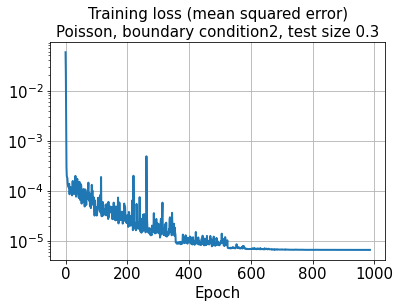

In [33]:
hist = history.history
plt.plot(hist['loss'], lw=2)
plt.title('Training loss (mean squared error)\nPoisson, boundary condition2, test size 0.3', size=15)
plt.xlabel('Epoch', size=15)
plt.yscale('log')
#plt.ylim([5e-5, 1e-1])
plt.tick_params(axis='both', which='major', labelsize=15)
plt.grid()
plt.savefig('')
plt.show()

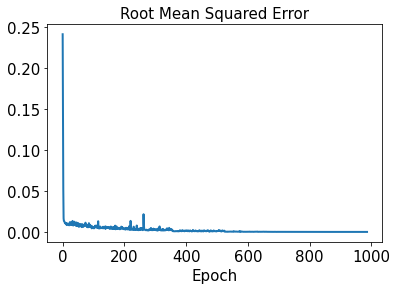

In [34]:
plt.plot(hist['rmse'], lw=2)
plt.title('Root Mean Squared Error', size=15)
plt.xlabel('Epoch', size=15)
plt.tick_params(axis='both', which='major', labelsize=15)
plt.show()

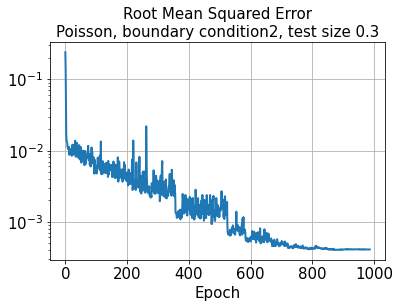

In [35]:
plt.plot(hist['rmse'], lw=2)
plt.title('Root Mean Squared Error\nPoisson, boundary condition2, test size 0.3', size=15)
plt.xlabel('Epoch', size=15)
plt.yscale('log')
plt.tick_params(axis='both', which='major', labelsize=15)
plt.grid()
plt.show()

In [36]:
#with mirrored_strategy.scope():
test_results = model.evaluate(x_train)

47/47 [==============================] - 0s 3ms/step - loss: 6.4941e-06 - rmse: 0.0000e+00


In [37]:
#with mirrored_strategy.scope():
decoded_train = model.predict(x_train)

47/47 [==============================] - 1s 12ms/step


In [38]:
#with mirrored_strategy.scope():
decoded_test = model.predict(x_test)

20/20 [==============================] - 0s 10ms/step


In [39]:
error_train_abs = np.abs(decoded_train - y_train)

In [40]:
error_test_abs = np.abs(decoded_test - y_test)

In [41]:
error_train_Cl_abs = np.abs(decoded_train[:,0,:] - y_train[:,0,:])

In [42]:
error_train_Cd_abs = np.abs(decoded_train[:,1,:] - y_train[:,1,:])

In [43]:
error_test_Cl_abs = np.abs(decoded_test[:,0,:] - y_test[:,0,:])

In [44]:
error_test_Cd_abs = np.abs(decoded_test[:,1,:] - y_test[:,1,:])

In [45]:
os.chdir("D:\\TrainedModels\\20221030")
model.save('Poisson_bc2_100kernel_2by2MaxPooling_2CNNlayer_testSize0.3.h5',
           overwrite=True, include_optimizer=True, save_format='h5')

In [46]:
l2_error_train = np.sqrt(np.sum((decoded_train - y_train)**2) / np.sum(y_train**2))
print(l2_error_train)

0.0005947980025373062


In [47]:
l2_error_test = np.sqrt(np.sum((decoded_test - y_test)**2) / np.sum(y_test**2))
print(l2_error_test)

0.0066343584869063095


In [48]:
l2_error_train_list = []
for i in range(0, len(aa_train)):
    l2_error_train_data = np.sqrt(np.sum((decoded_train[i] - y_train[i])**2) / np.sum(y_train[i]**2))
    l2_error_train_list.append(l2_error_train_data)
#print(l2_error_train_list)

In [49]:
l2_error_test_list = []
for i in range(0, len(aa_test)):
    l2_error_test_data = np.sqrt(np.sum((decoded_test[i] - y_test[i])**2) / np.sum(y_test[i]**2))
    l2_error_test_list.append(l2_error_test_data)
#print(l2_error_test_list)

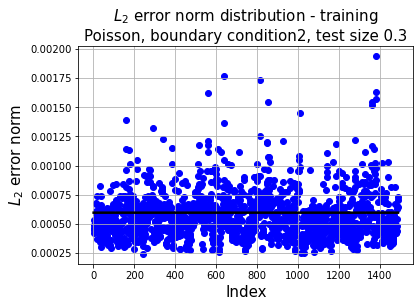

In [50]:
plt.plot(np.linspace(1, aa_train.shape[0], aa_train.shape[0]),
         l2_error_train*np.ones(aa_train.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_train.shape[0], aa_train.shape[0]), l2_error_train_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm distribution - training\nPoisson, boundary condition2, test size 0.3',
          fontsize=15)
plt.grid()
save_variance_name = "20221030L2ErrorDistribution_Poisson_bc2(training).jpg"
plt.savefig(save_variance_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

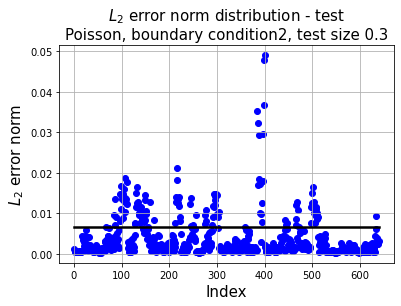

In [51]:
plt.plot(np.linspace(1, aa_test.shape[0], aa_test.shape[0]),
         l2_error_test*np.ones(aa_test.shape[0],), 'k', lw=2.5)
plt.scatter(np.linspace(1, aa_test.shape[0], aa_test.shape[0]), l2_error_test_list, c='b')
plt.xlabel('Index', fontsize=15)
plt.ylabel('$L_2$ error norm', fontsize=15)
plt.title('$L_2$ error norm distribution - test\nPoisson, boundary condition2, test size 0.3',
          fontsize=15)
plt.grid()
save_variance_name = "20221030L2ErrorDistribution_Poisson_bc2(test).jpg"
plt.savefig(save_variance_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

In [52]:
os.chdir("D:\\CNN_poisson_files\\images\\20221030\\testSize0.3")

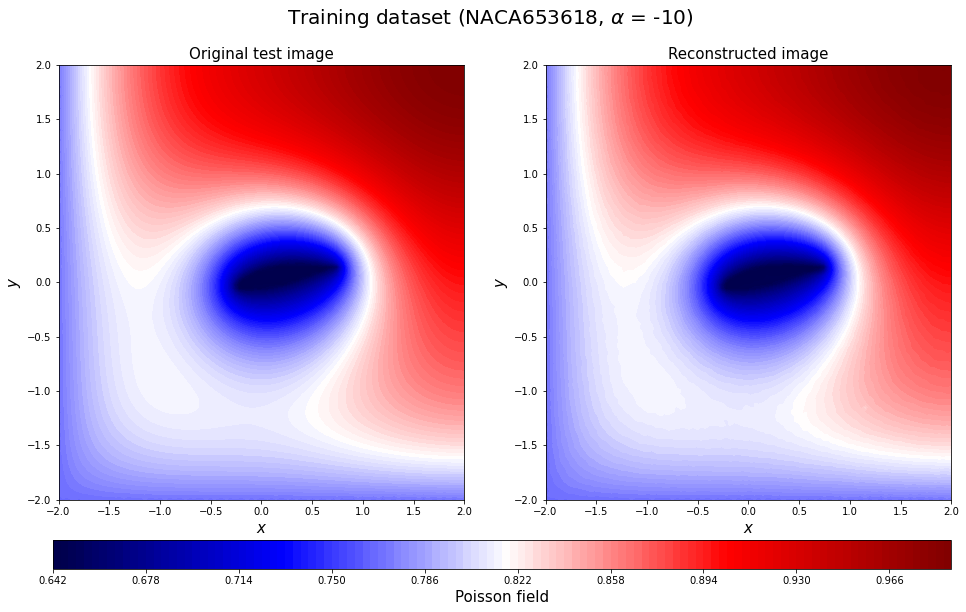

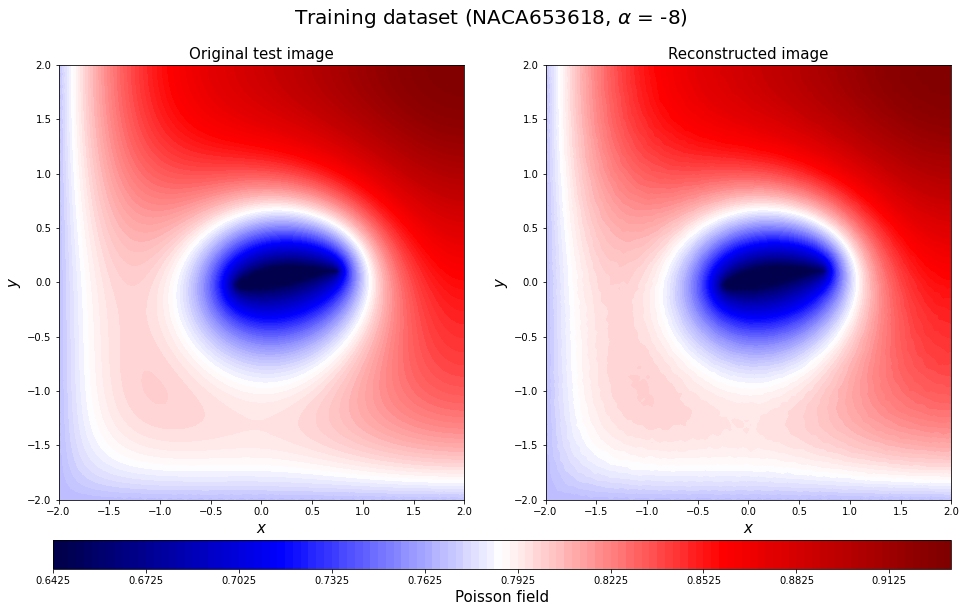

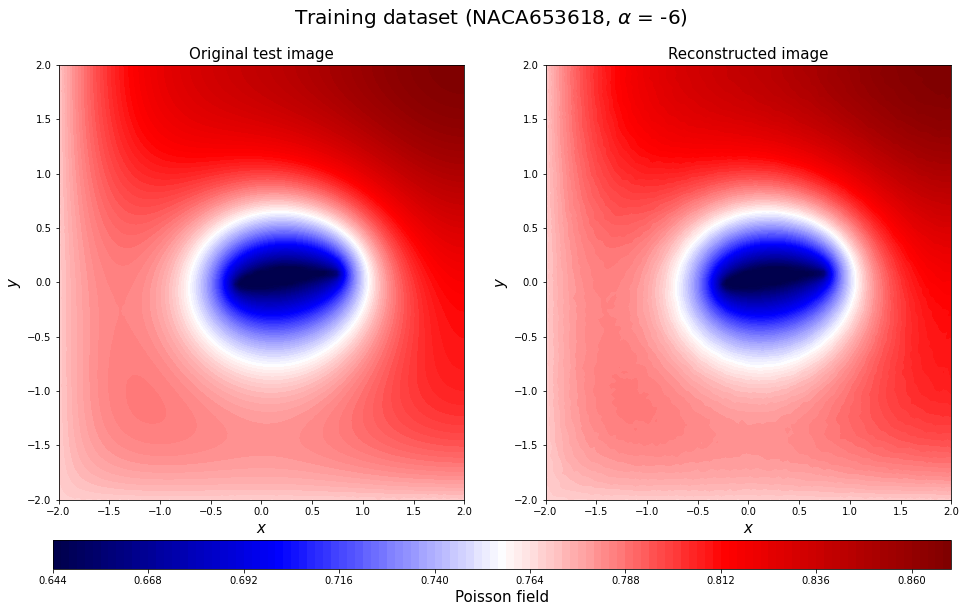

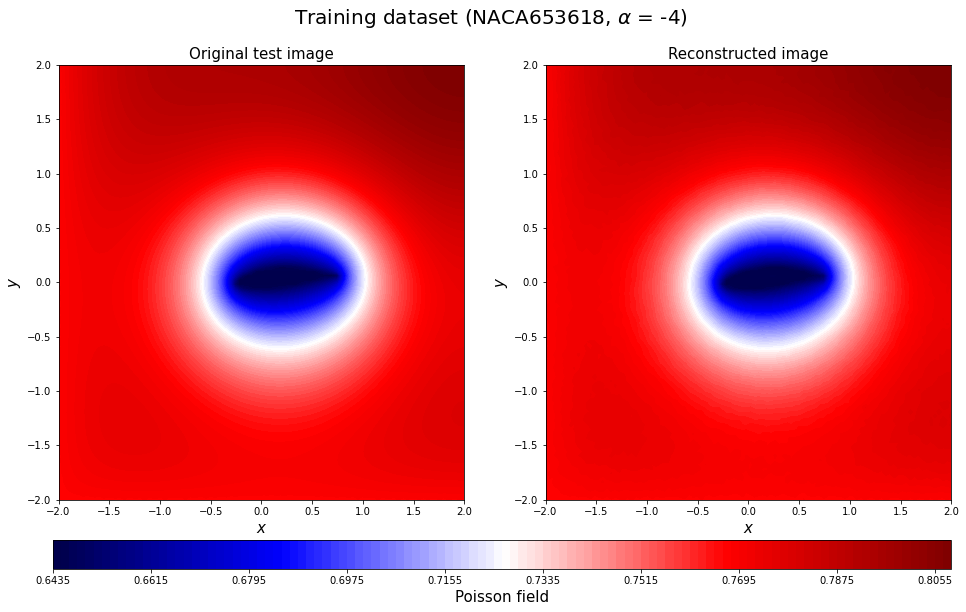

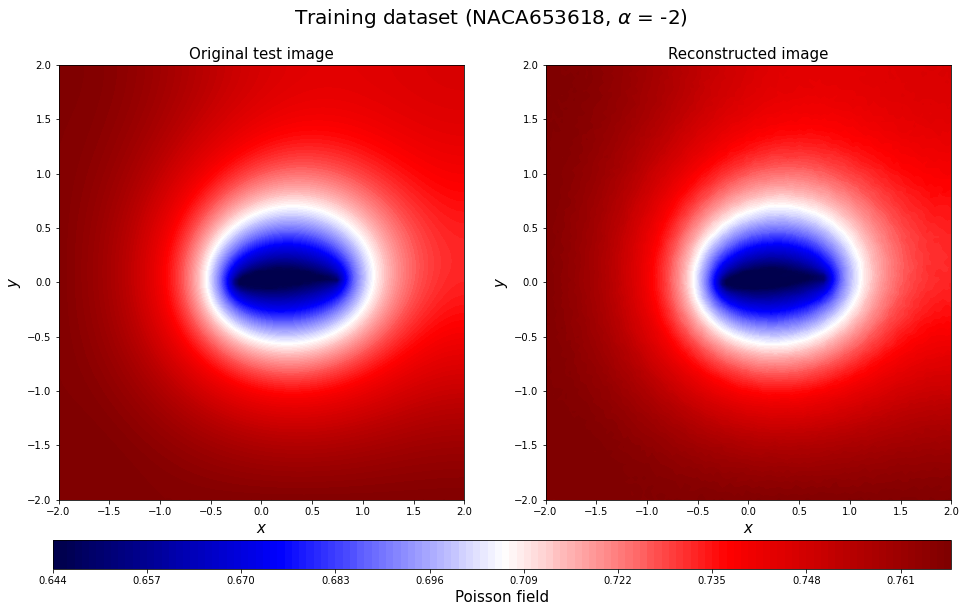

...

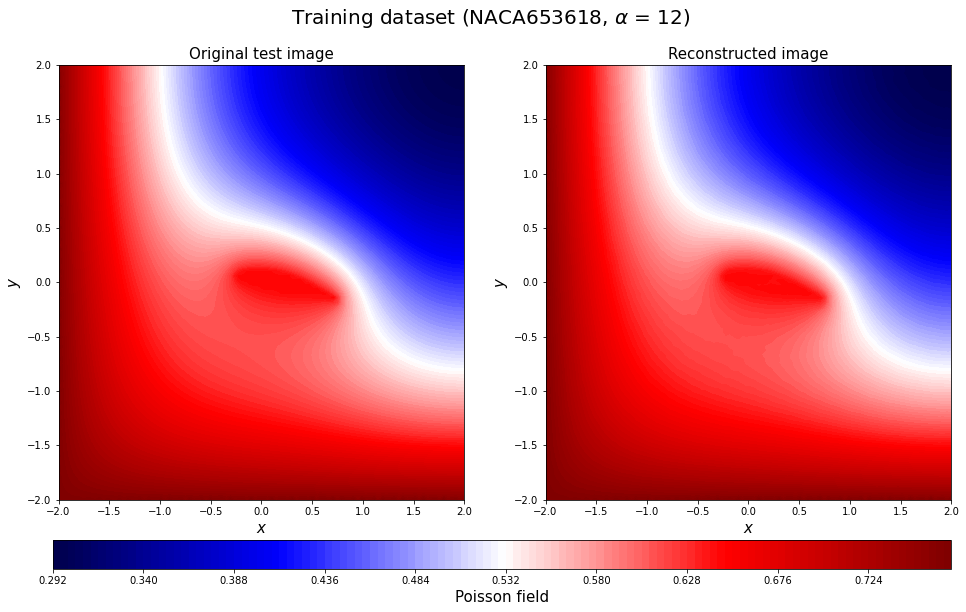

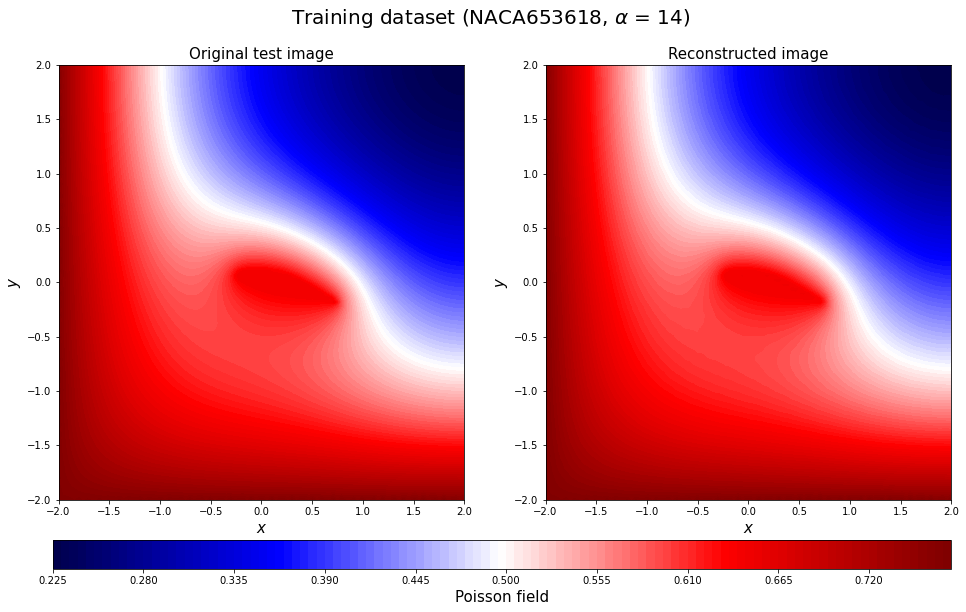

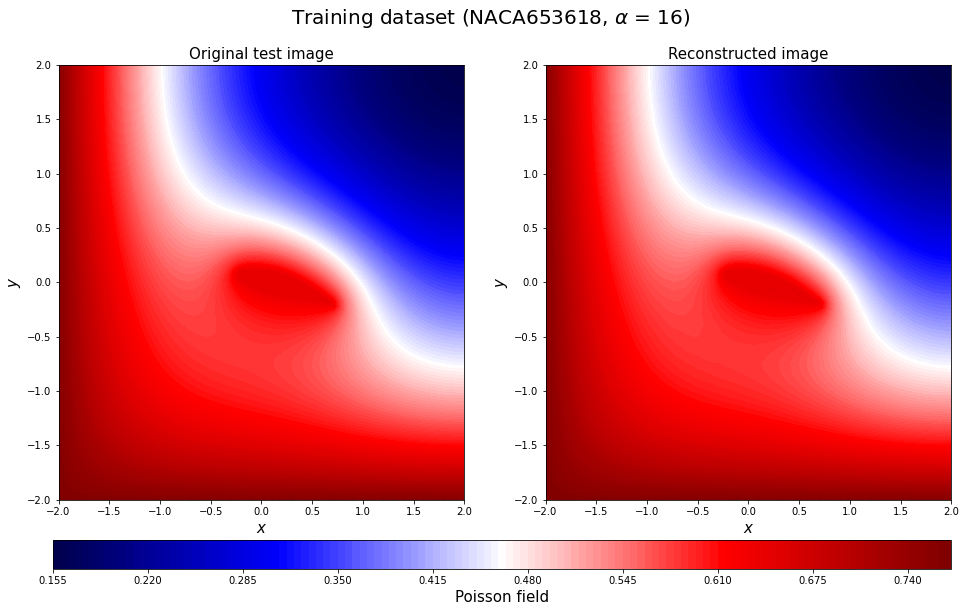

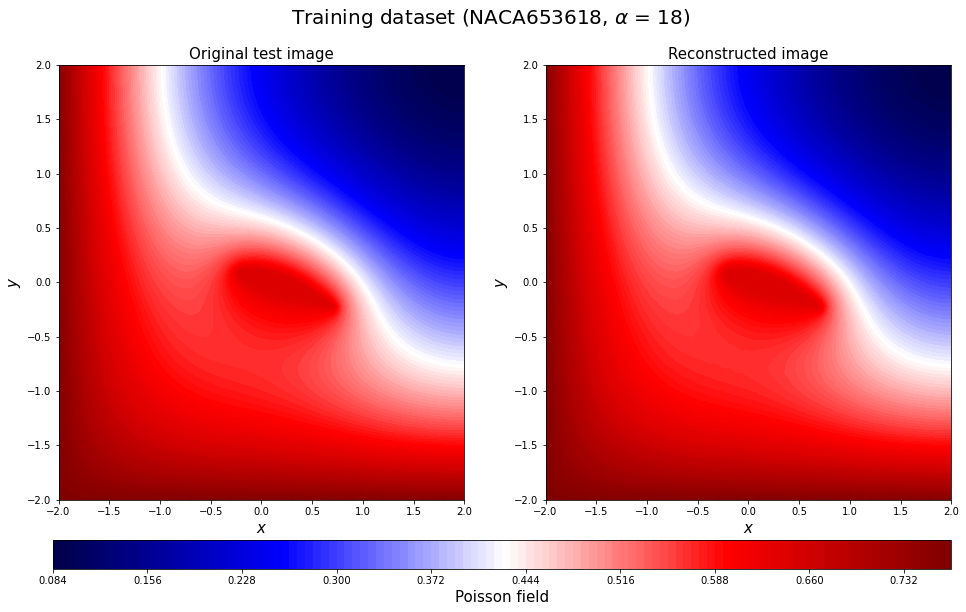

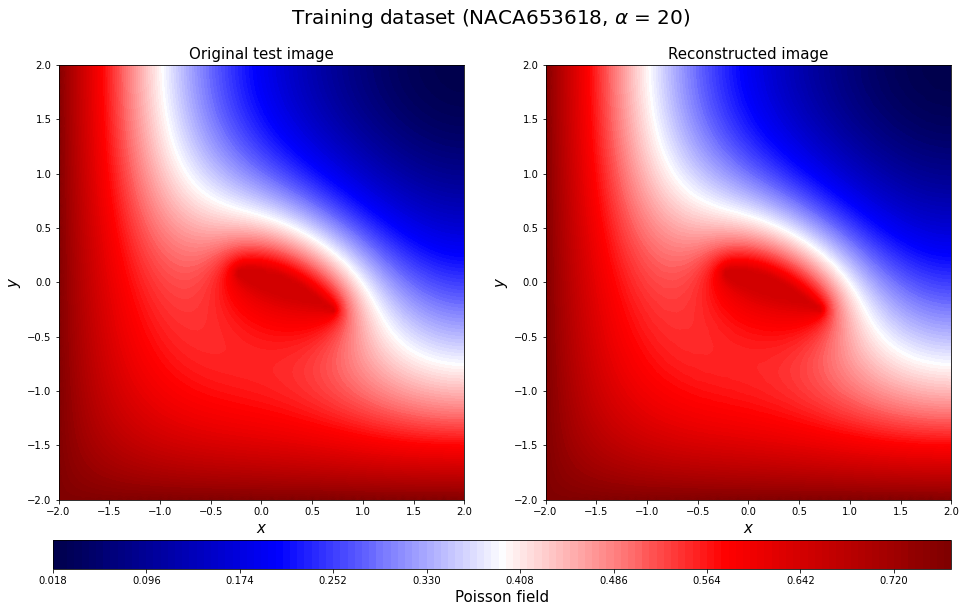

In [53]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_train0_rotate = y_train[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_train[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_train0_rotate, vmin=np.min(y_train0_rotate),
                      vmax = np.max(y_train0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_train0_rotate),
                      vmax = np.max(y_train0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Training dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_train[c])[3:-2], aa_train[c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(training)"+str(np.array2string(geo_train[c])[3:-2])+str(aa_train[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

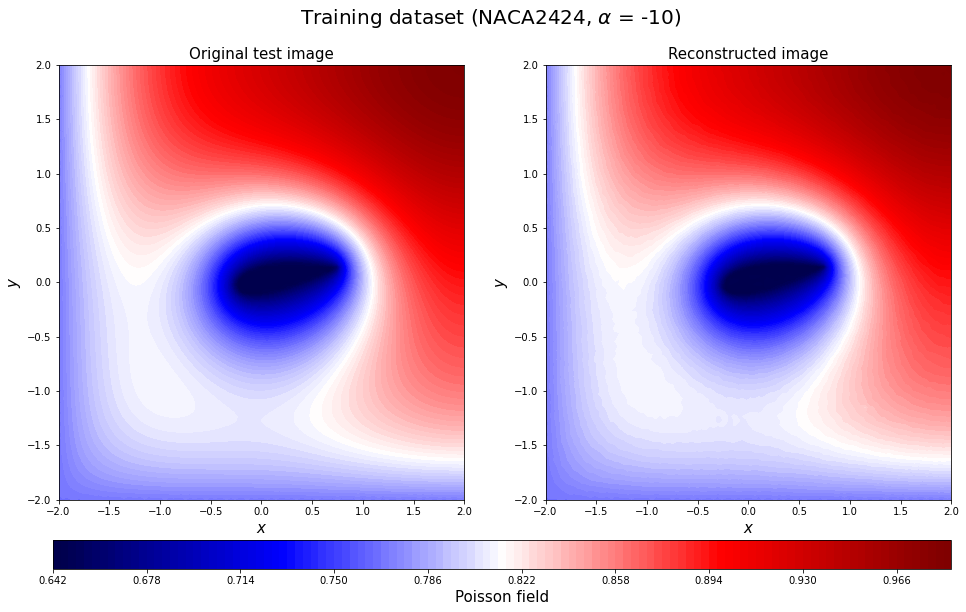

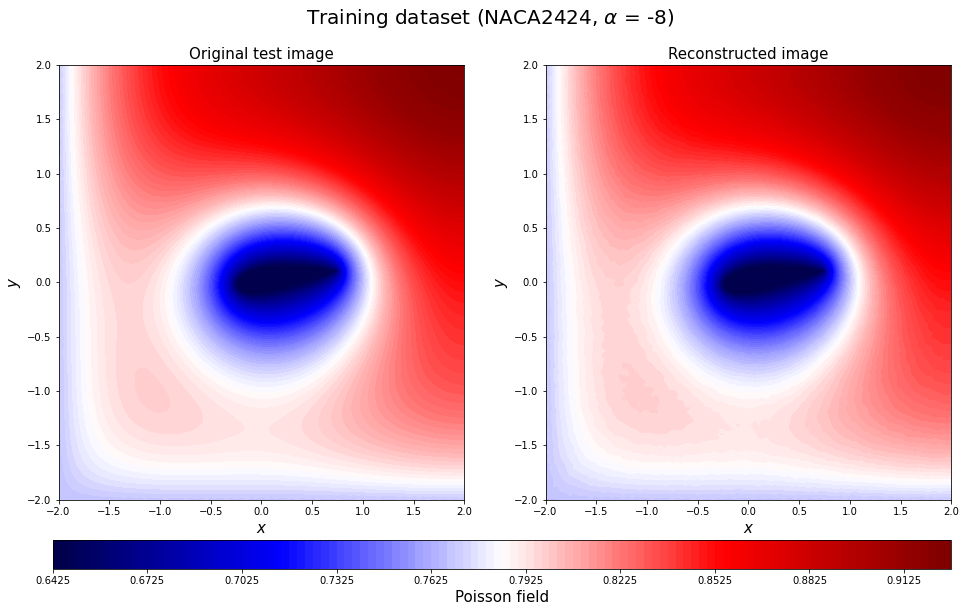

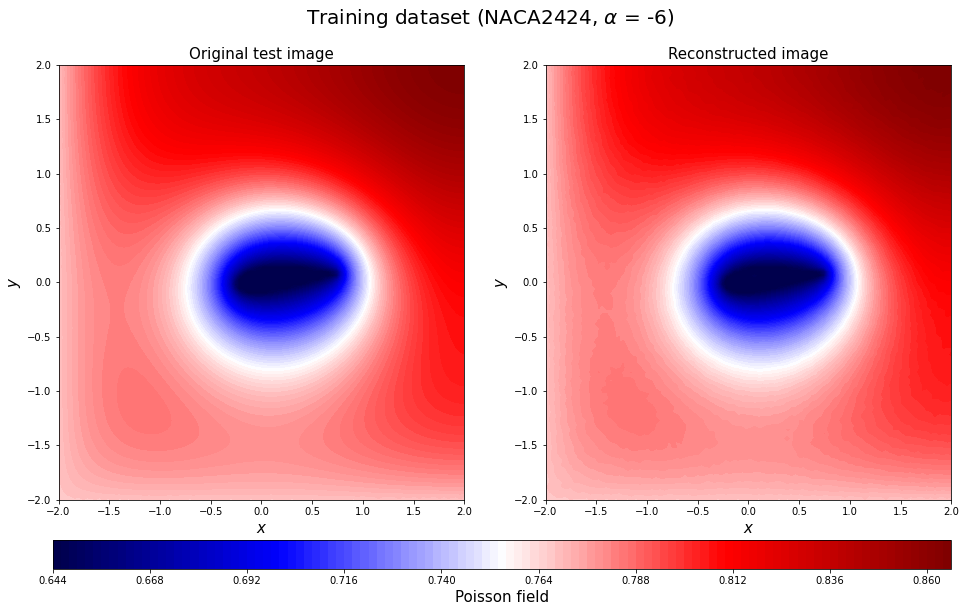

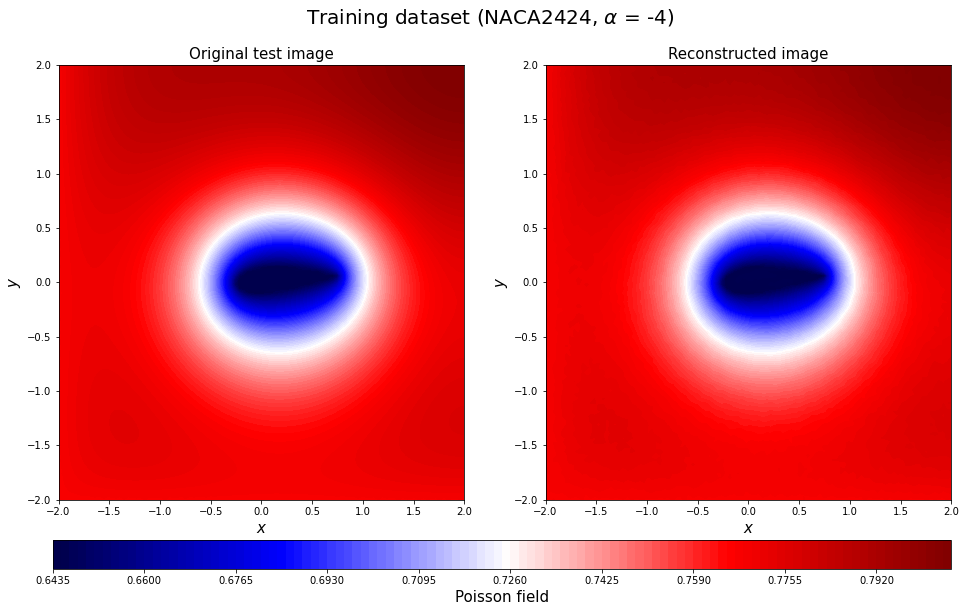

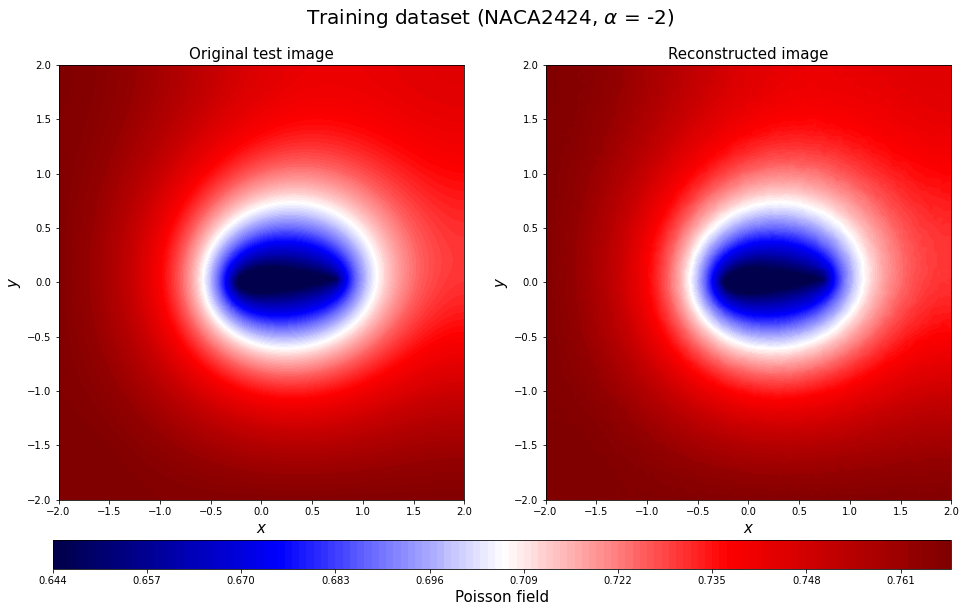

...

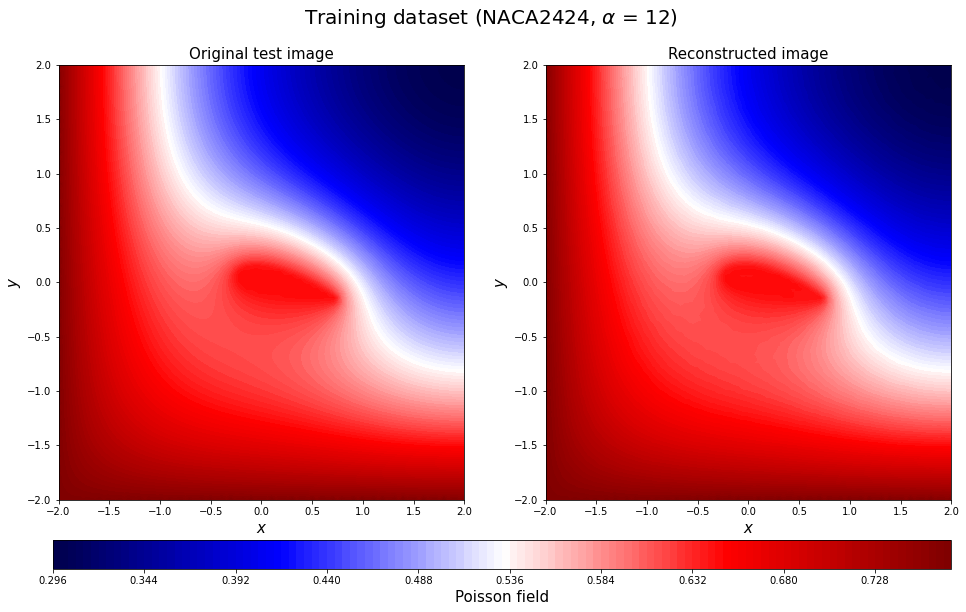

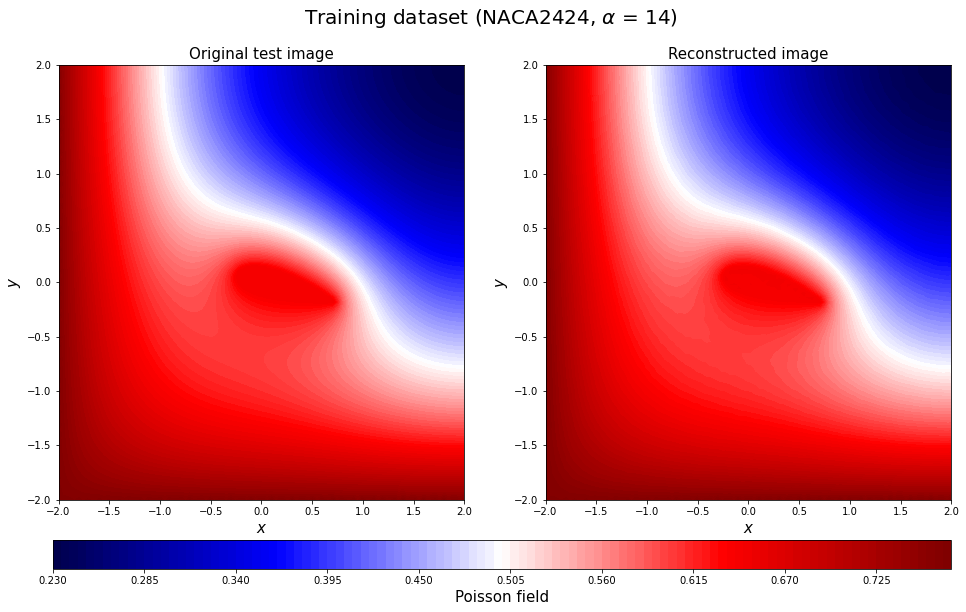

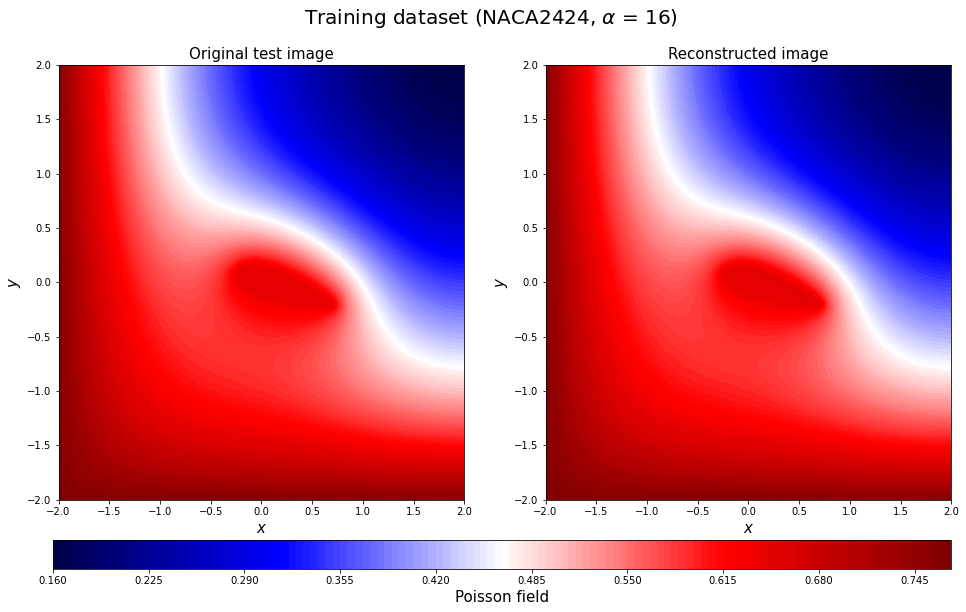

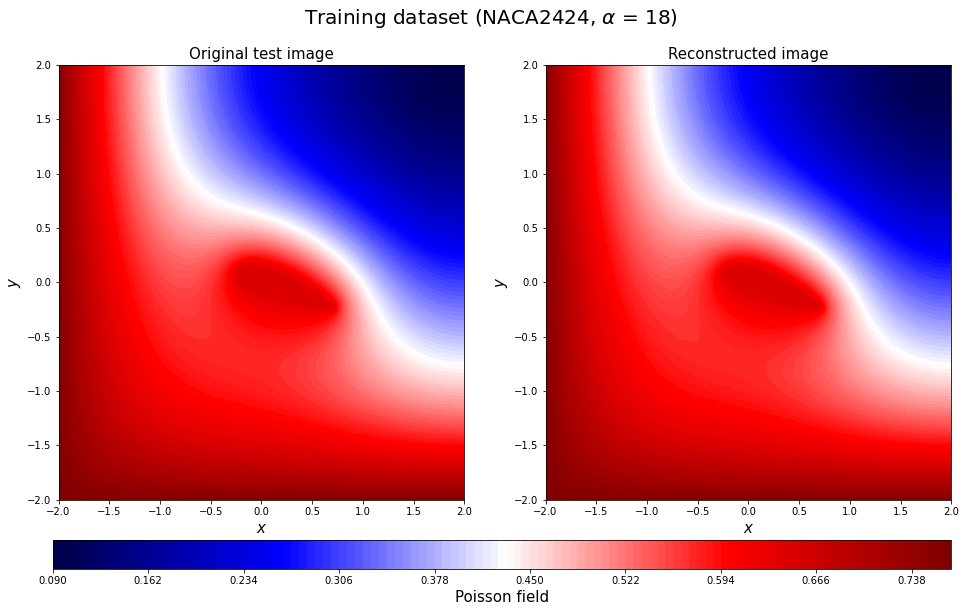

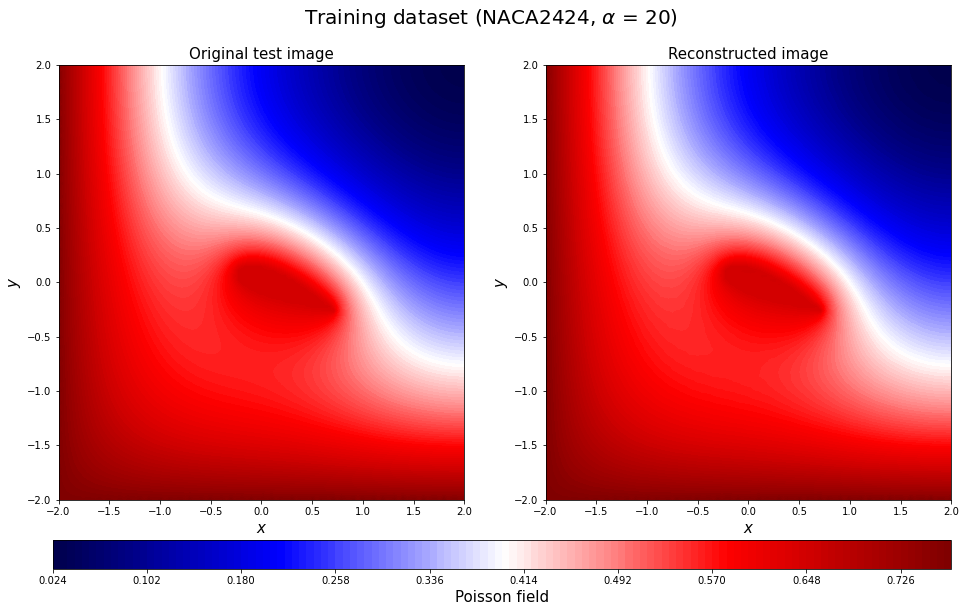

In [54]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_train20_rotate = y_train[20*16+c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_train[20*16+c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_train20_rotate, vmin=np.min(y_train20_rotate),
                      vmax=np.max(y_train20_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_train20_rotate),
                      vmax=np.max(y_train20_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Training dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_train[20*16+c])[3:-2], aa_train[20*16+c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(training)"+str(np.array2string(geo_train[20*16+c])[3:-2])+str(aa_train[20*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

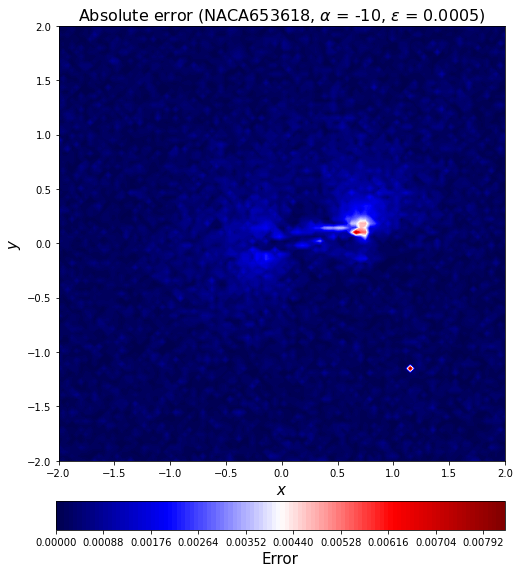

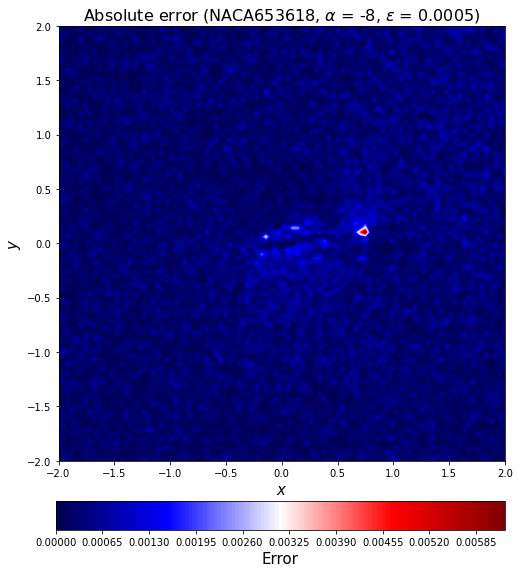

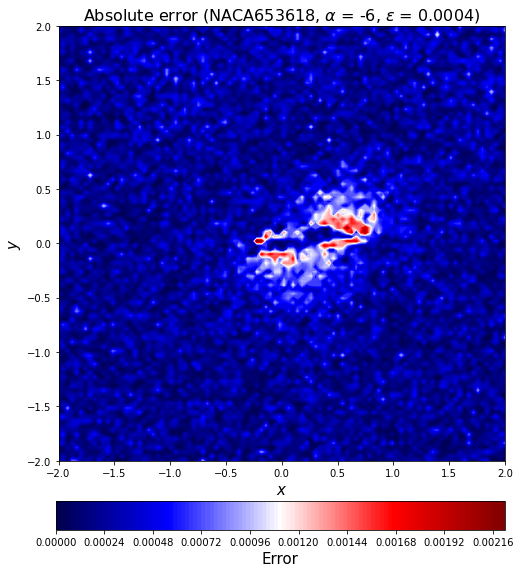

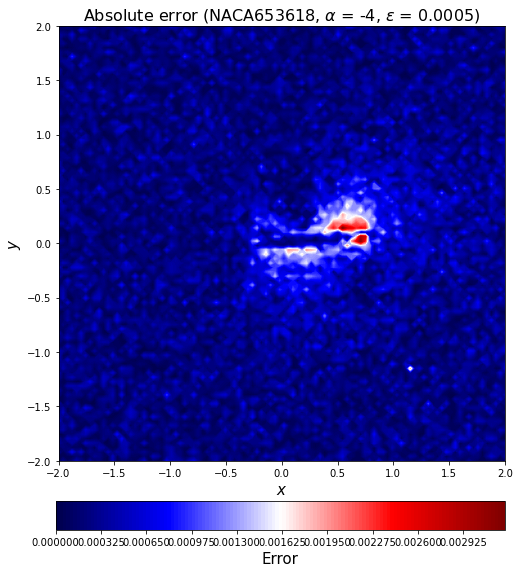

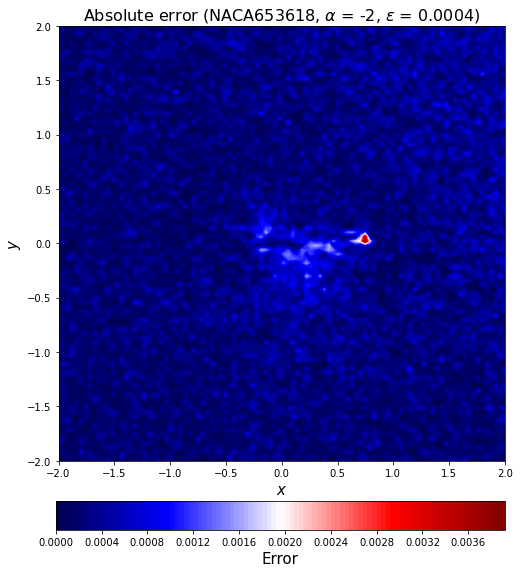

...

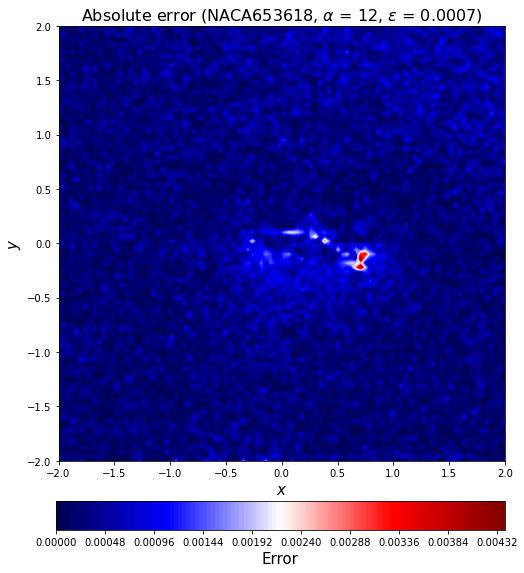

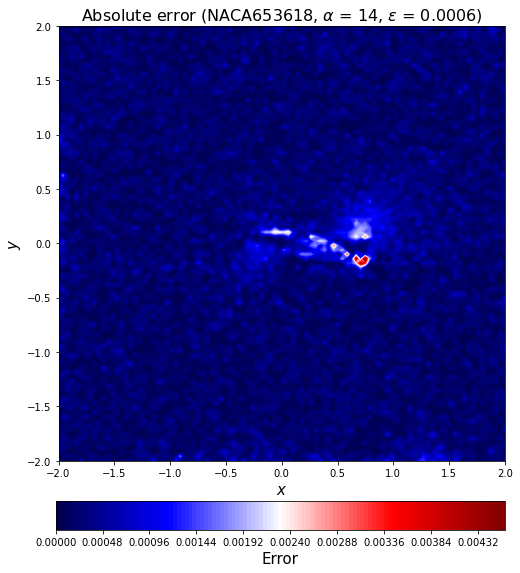

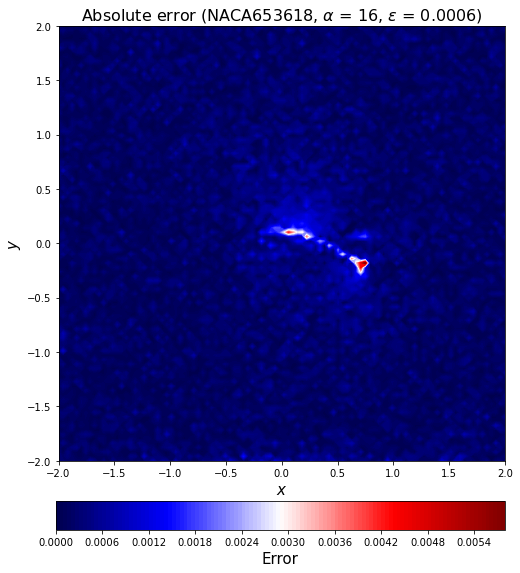

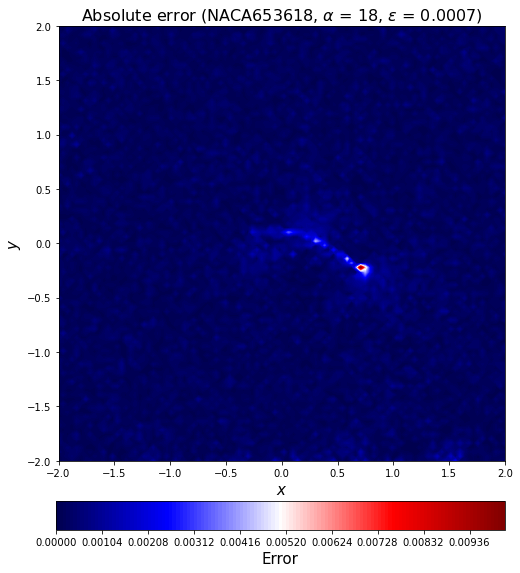

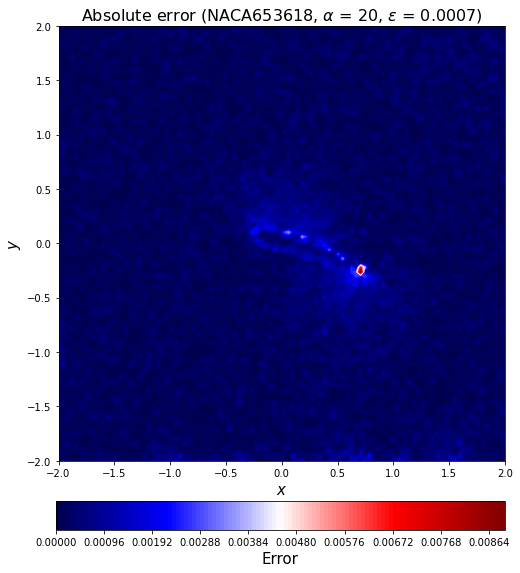

In [55]:
for c in range(0,16):
    error_train_abs2_rotate = error_train_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_train_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_train[c])[3:-2],
                                                                             aa_train[c], l2_error_train_list[c]), fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(training)"+str(np.array2string(geo_train[c])[3:-2])+str(aa_train[c])[3:-2]+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

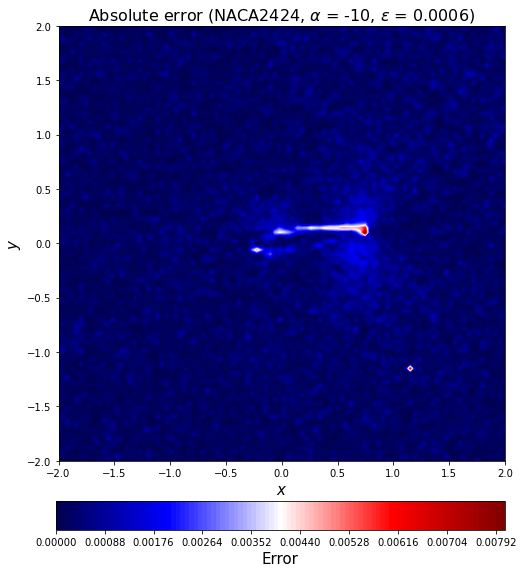

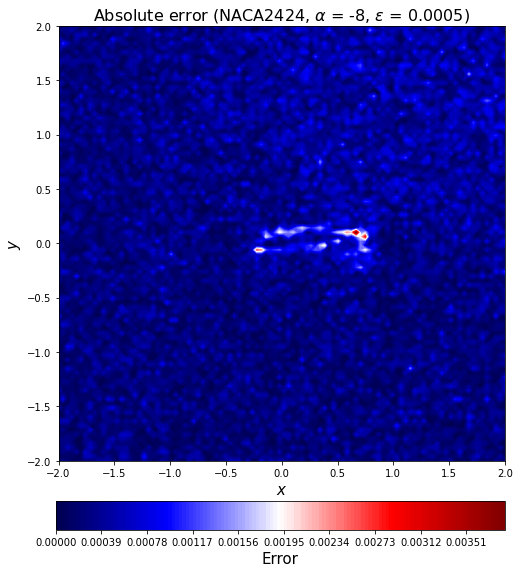

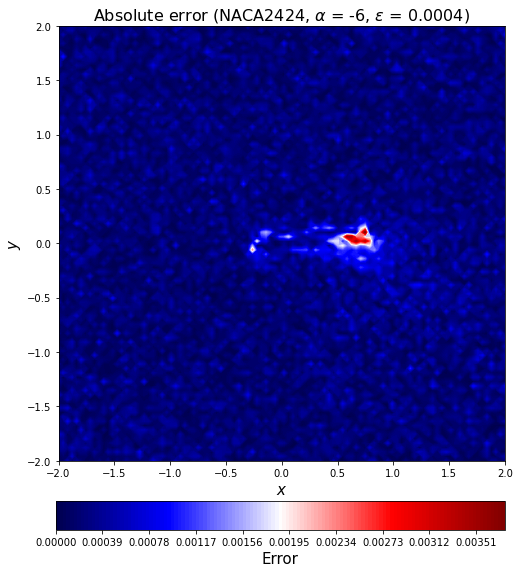

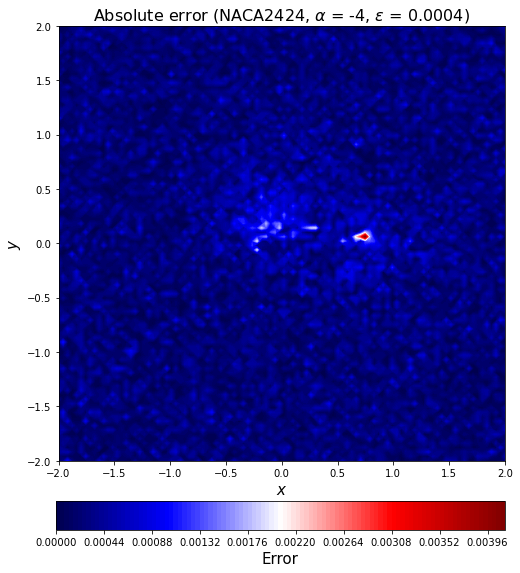

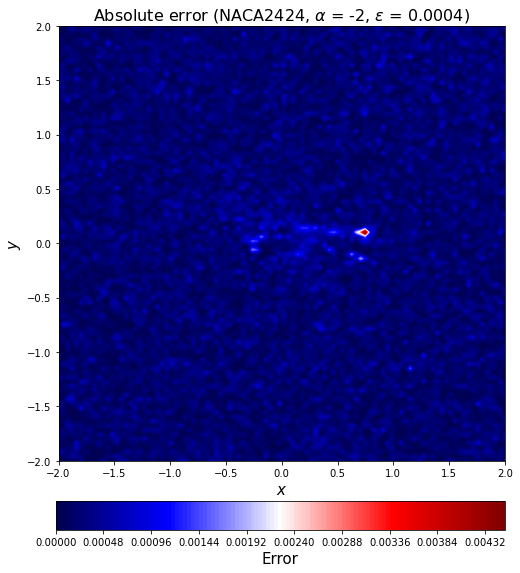

...

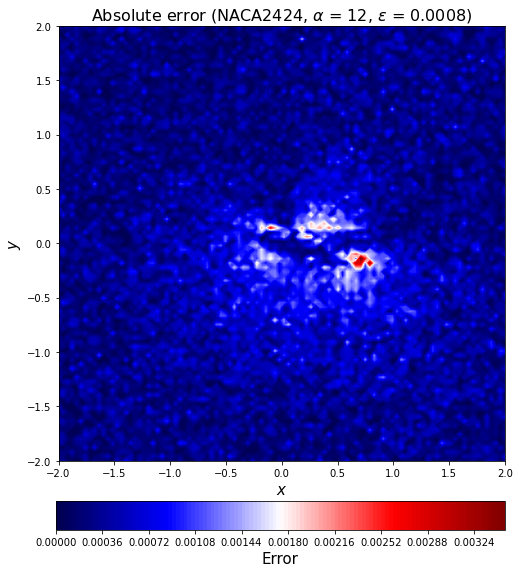

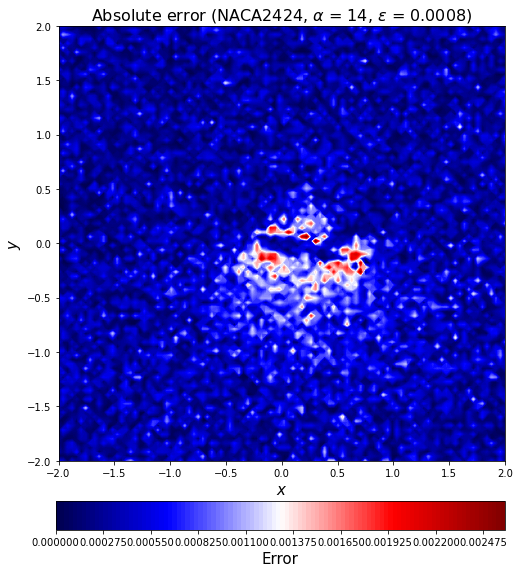

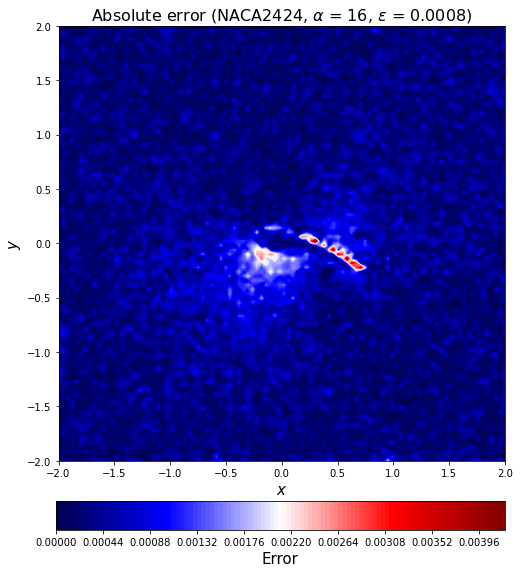

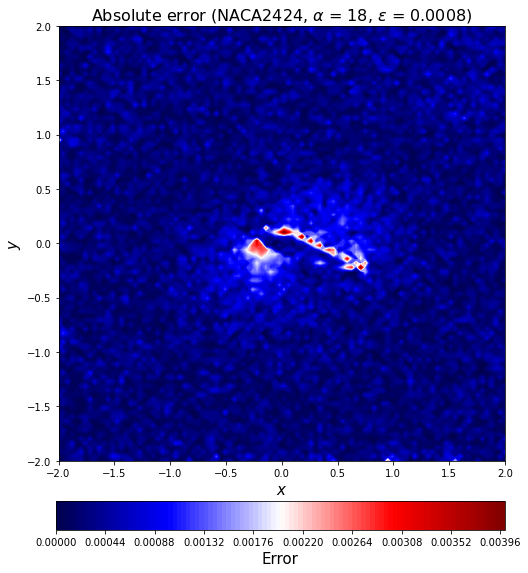

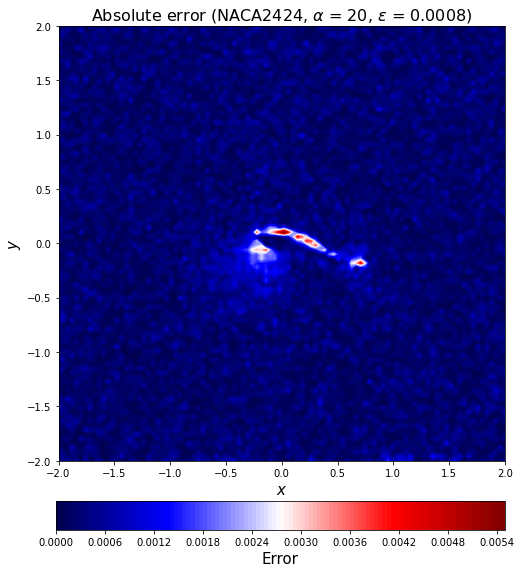

In [56]:
for c in range(0,16):
    error_train_abs2_rotate = error_train_abs[16*20+c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_train_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_train[16*20+c])[3:-2],
                                                                             aa_train[16*20+c], l2_error_train_list[16*20+c]),fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(training)"+str(np.array2string(geo_train[16*20+c])[3:-2])+str(aa_train[16*20+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

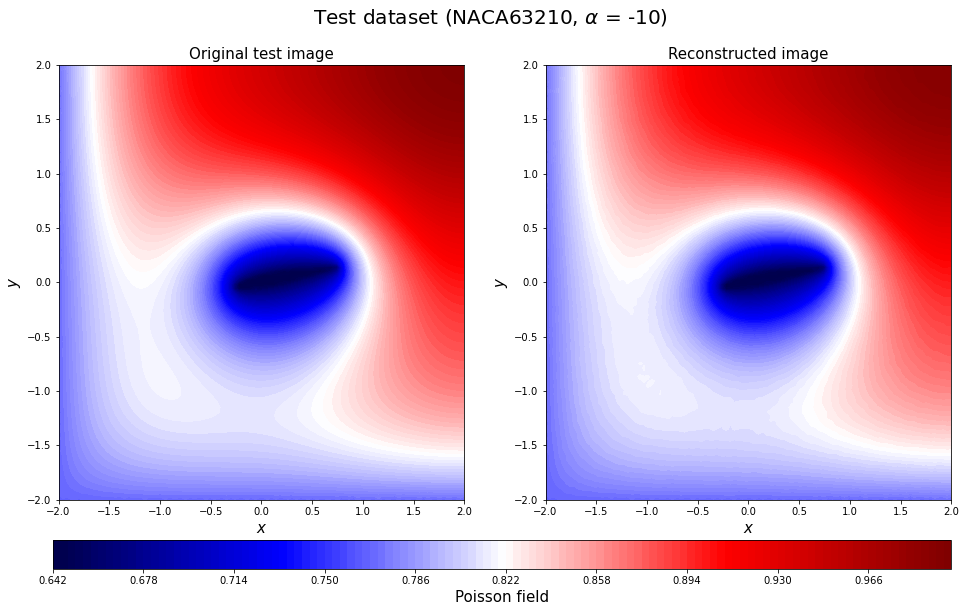

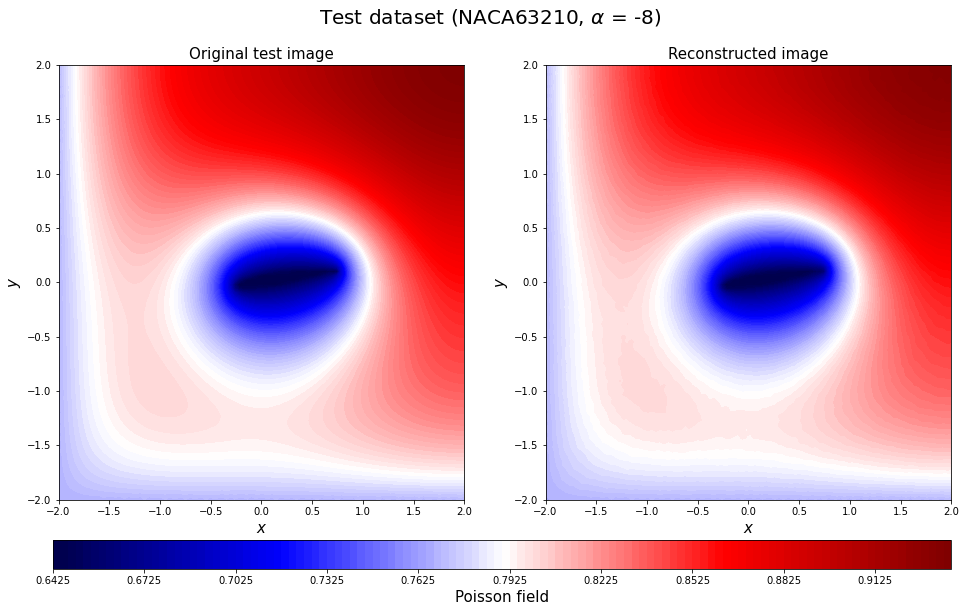

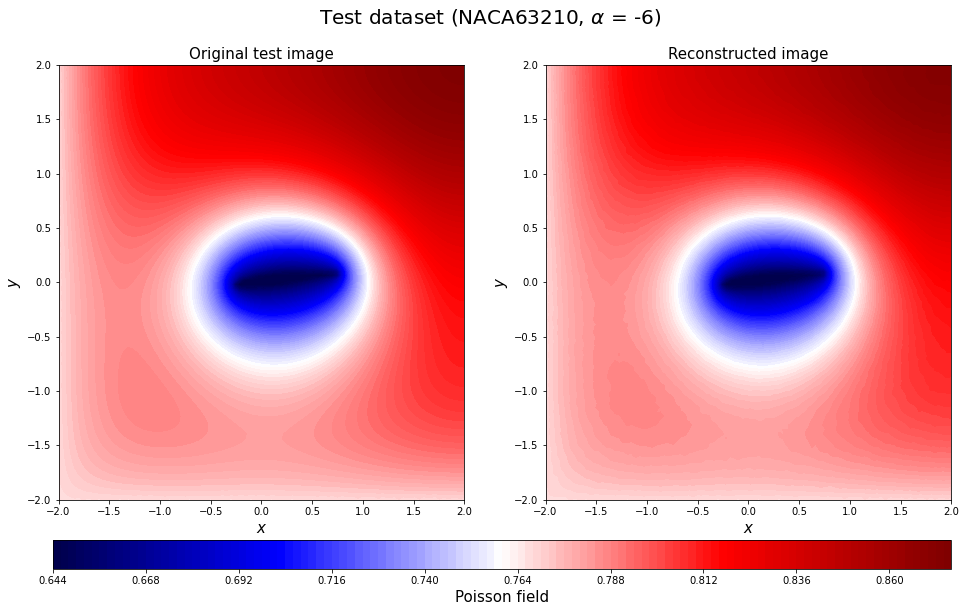

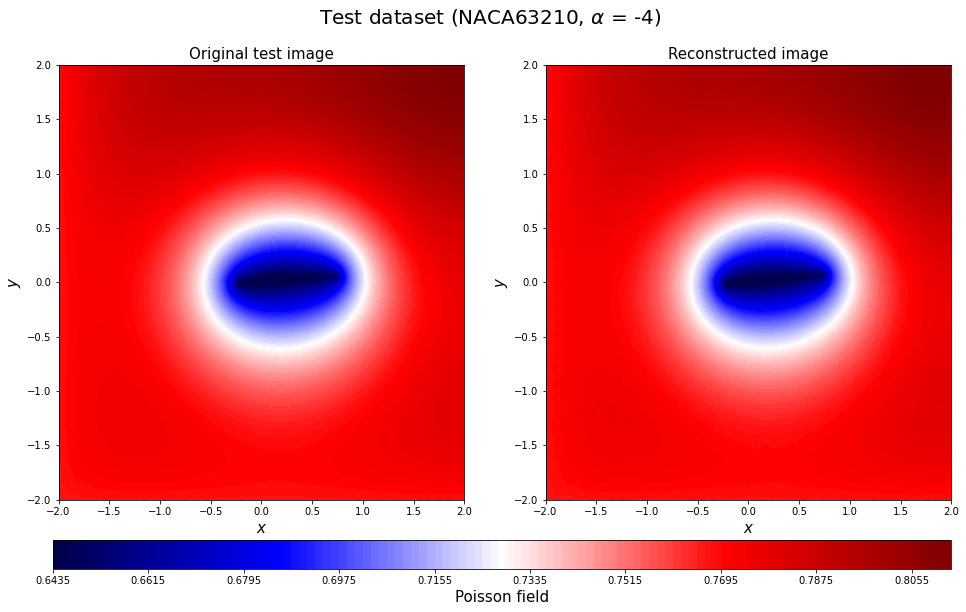

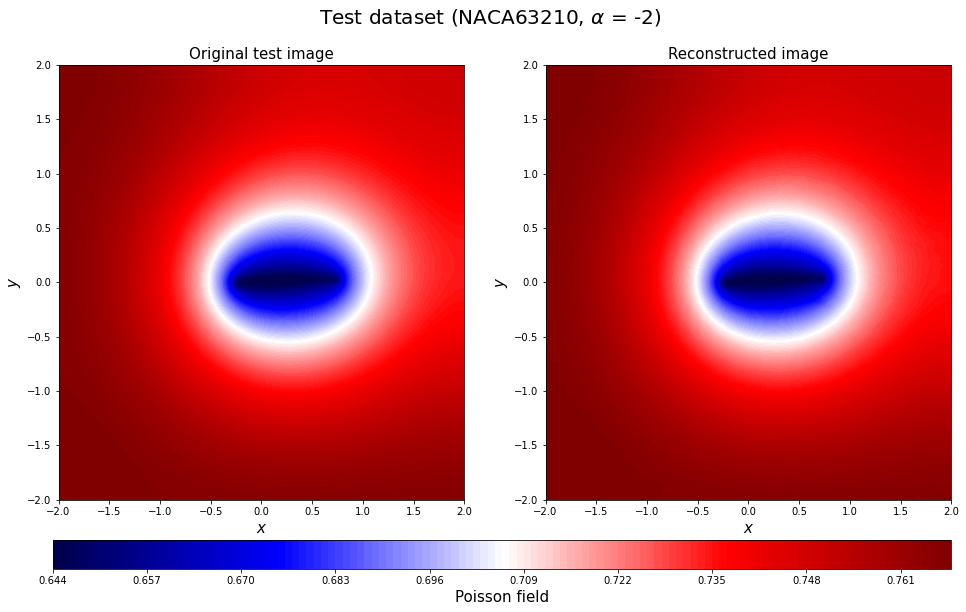

...

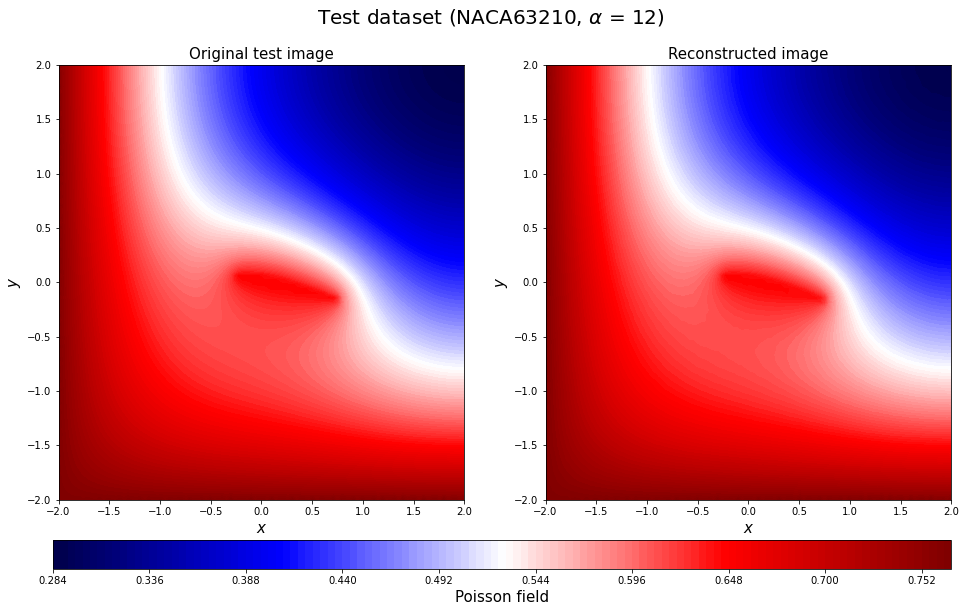

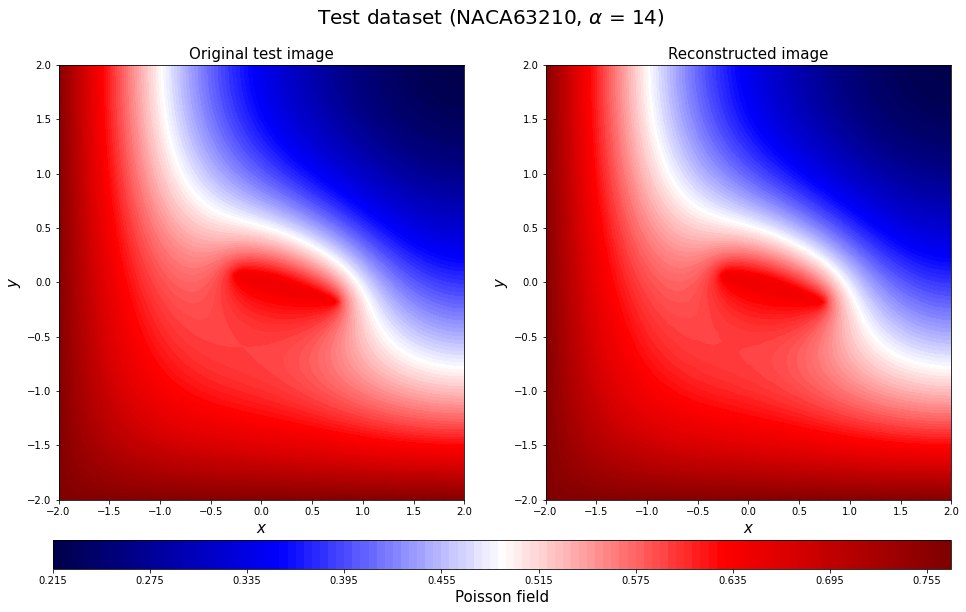

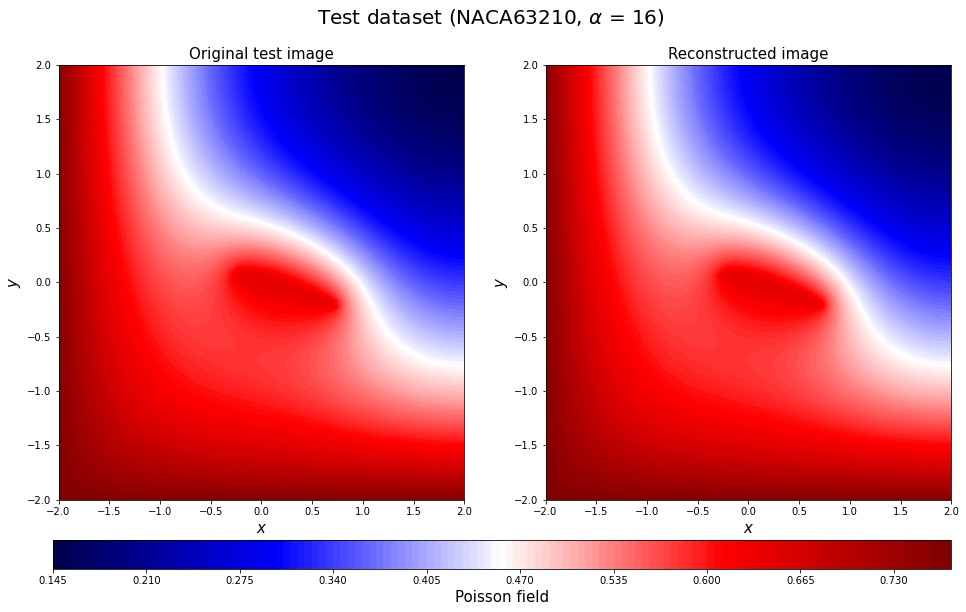

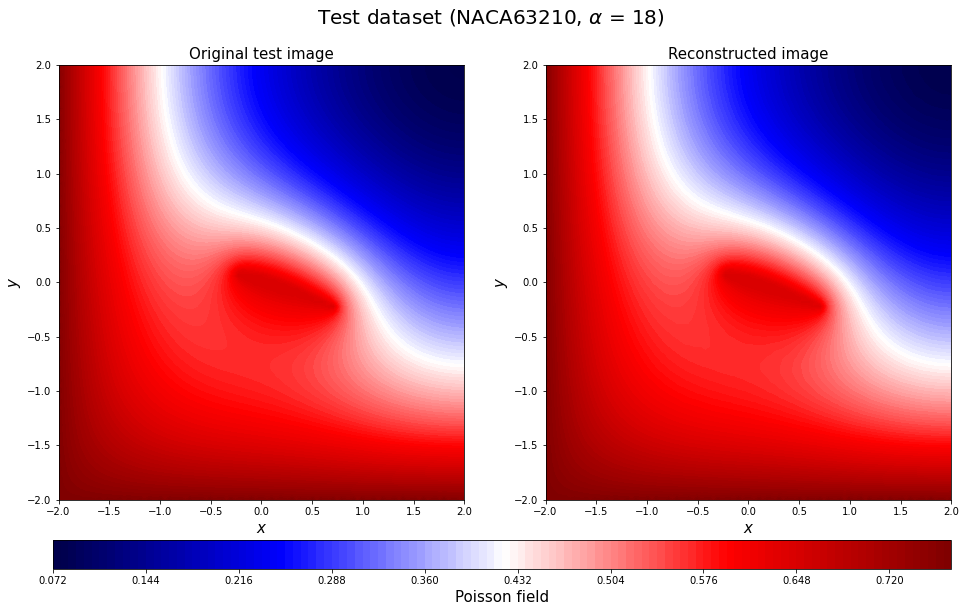

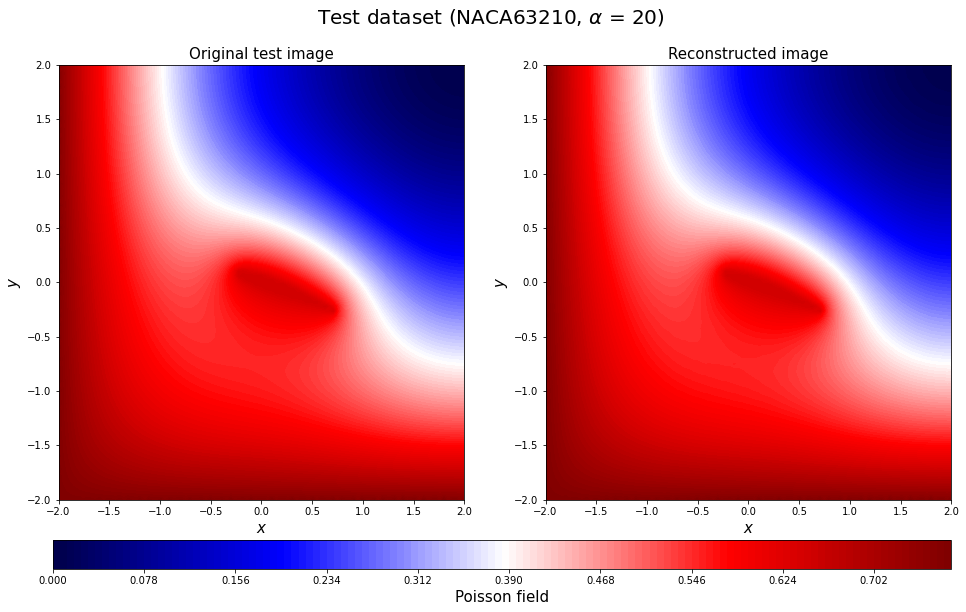

In [57]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_test2_rotate = y_test[2*16+c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[2*16+c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test2_rotate, vmin=np.min(y_test2_rotate), 
                      vmax=np.max(y_test2_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test2_rotate), 
                      vmax=np.max(y_test2_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[2*16+c])[3:-2], aa_test[2*16+c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[2*16+c])[3:-2])+str(aa_test[2*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

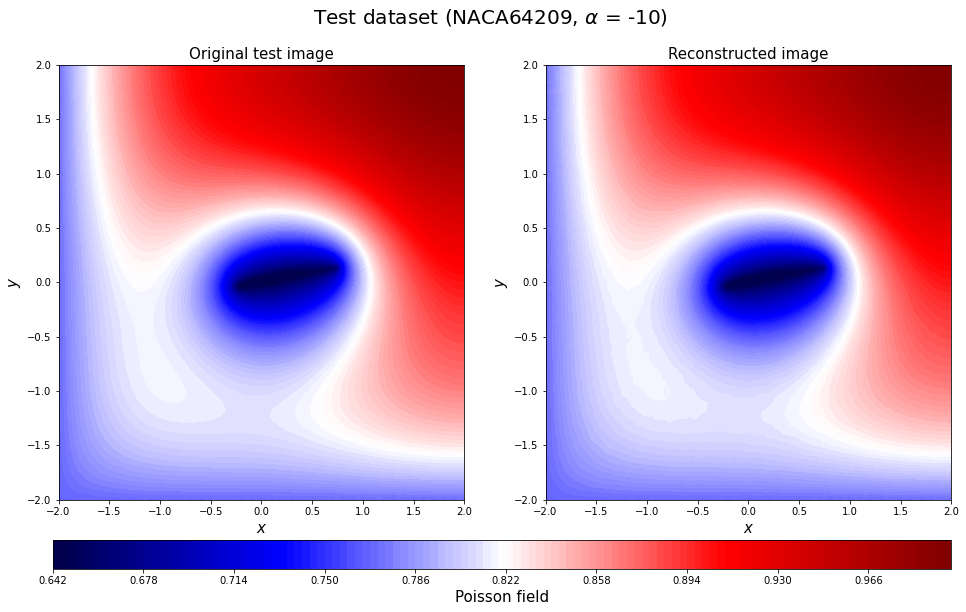

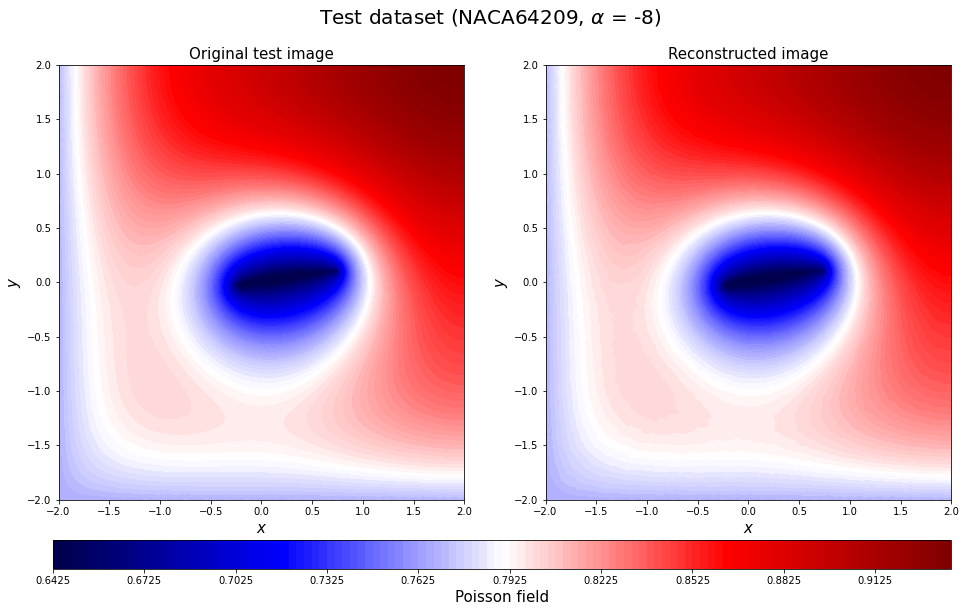

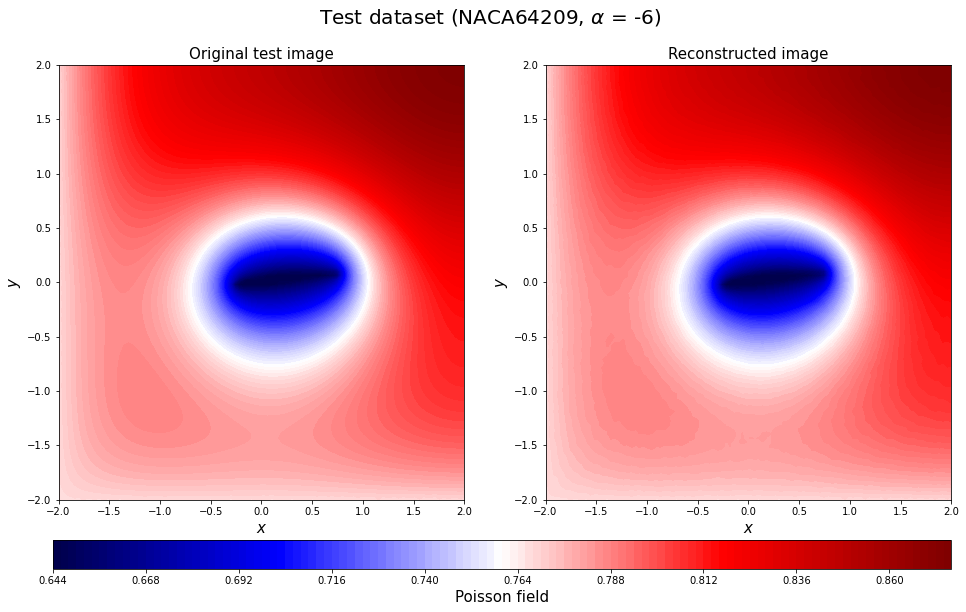

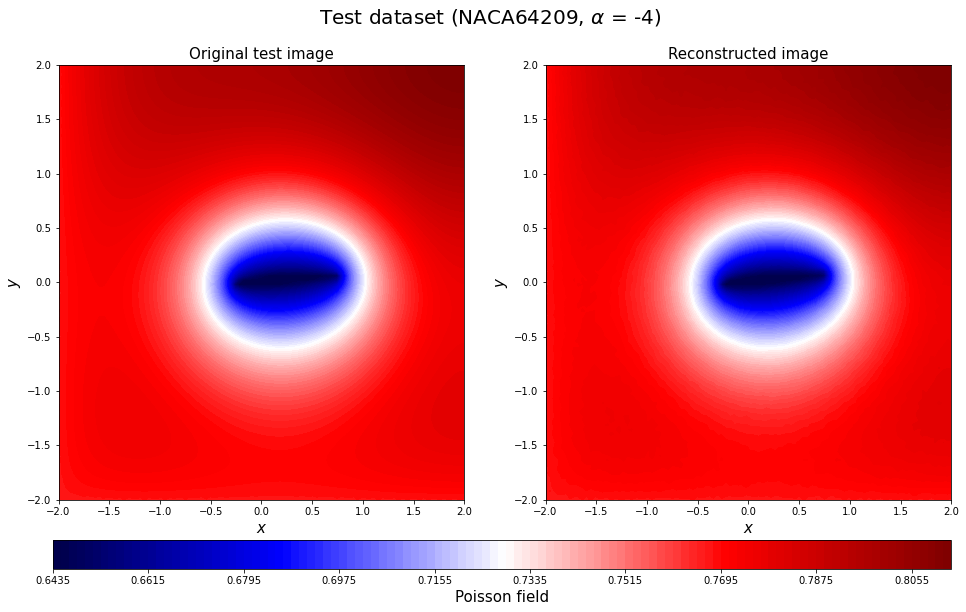

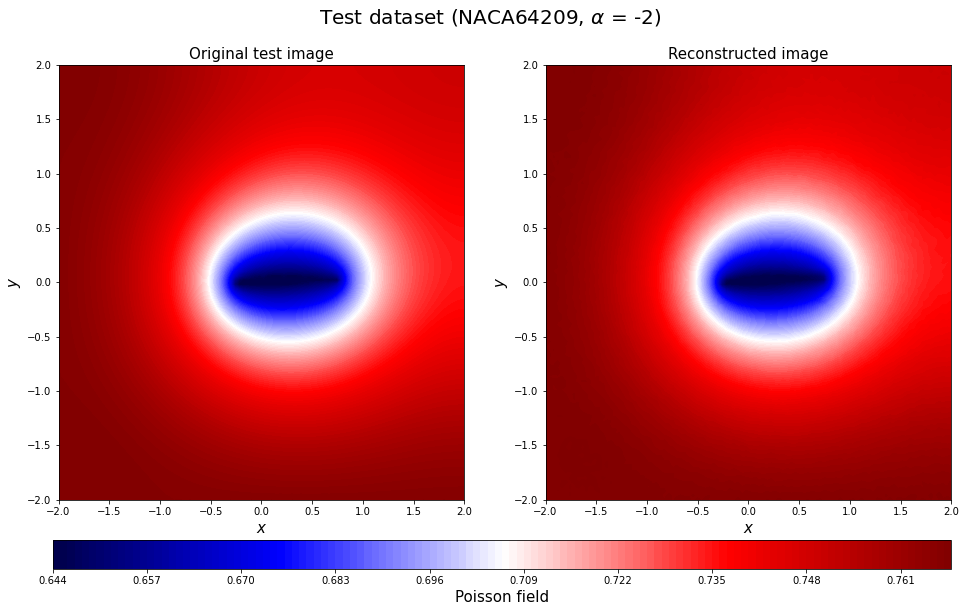

...

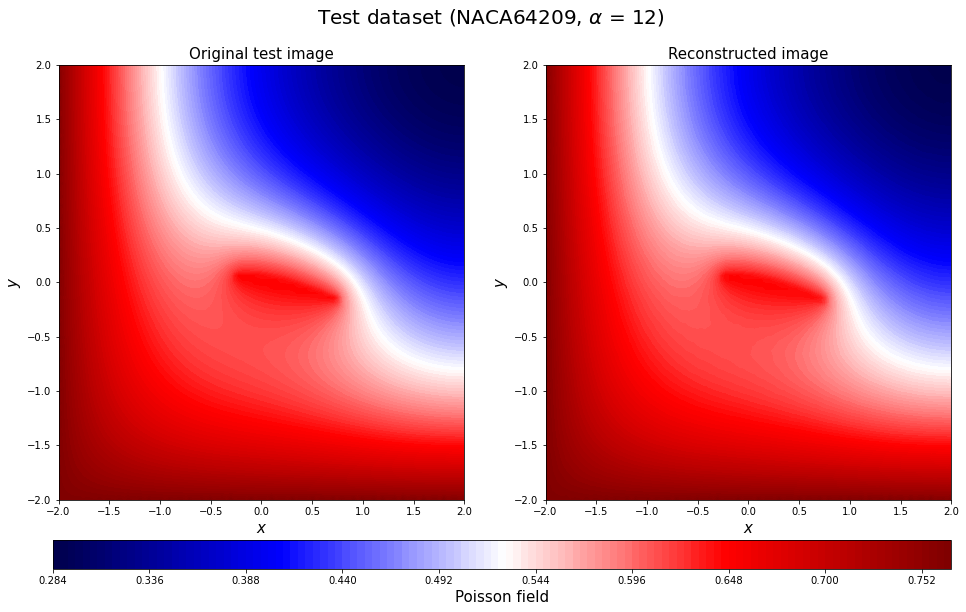

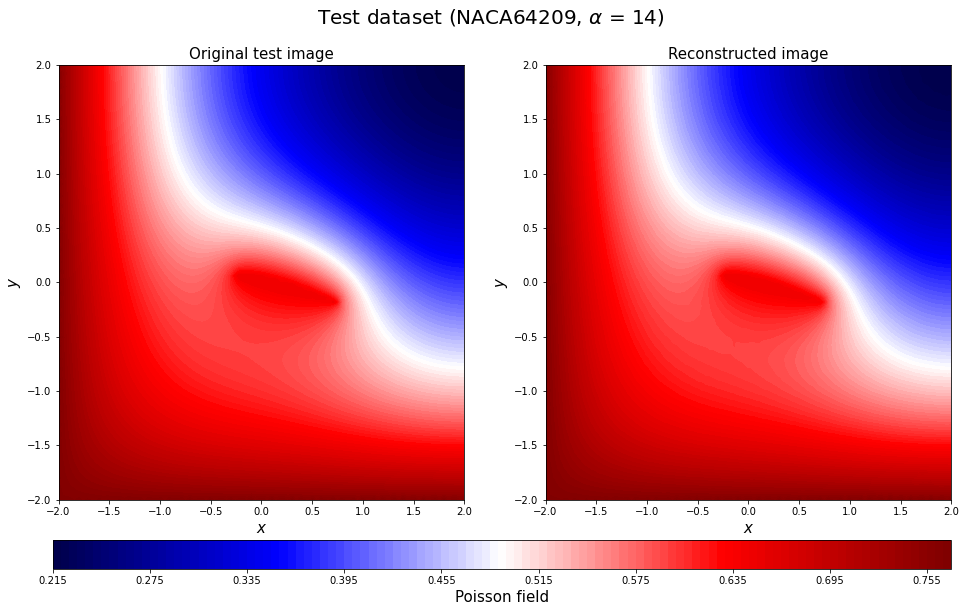

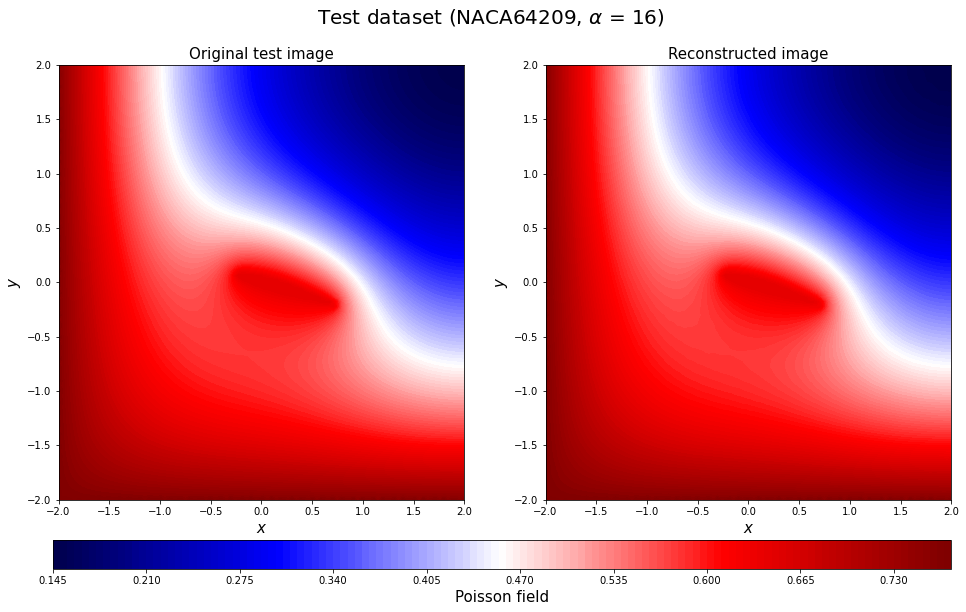

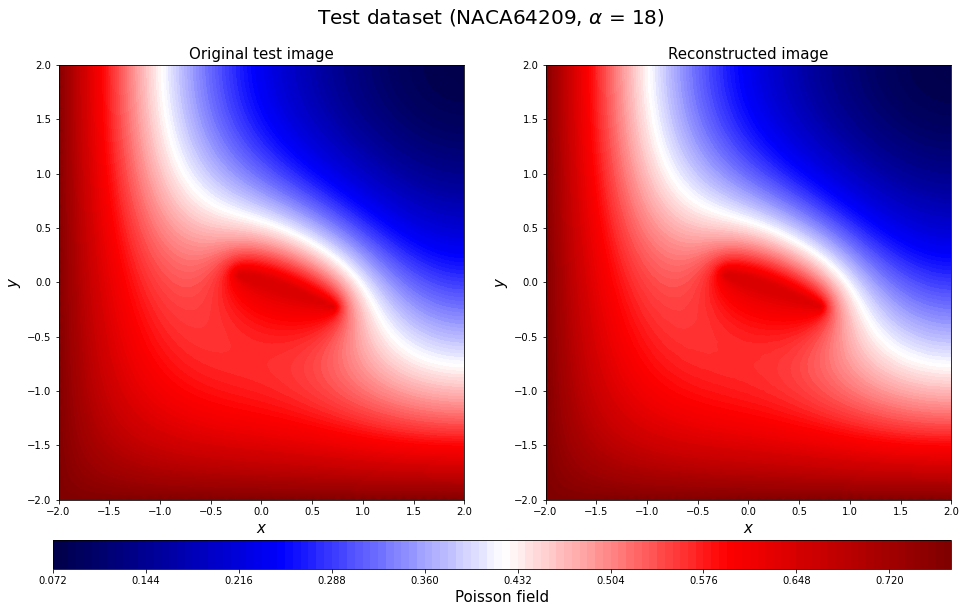

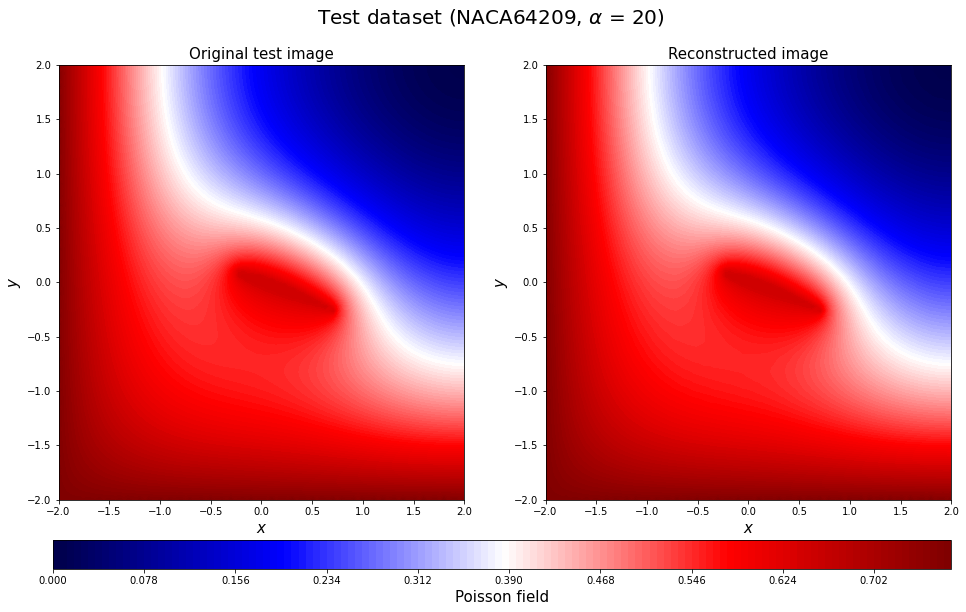

In [58]:
for c in range(0,16):
    plt.figure(figsize=(16, 8))
    y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                      vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                      vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

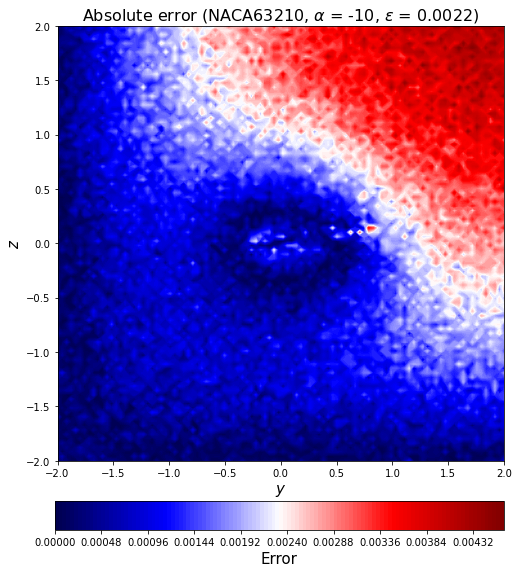

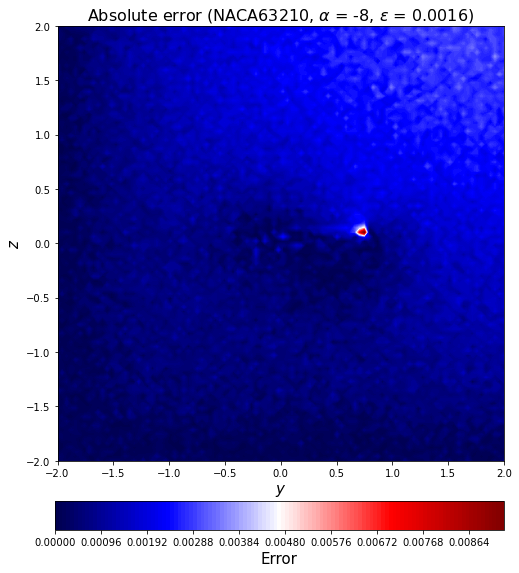

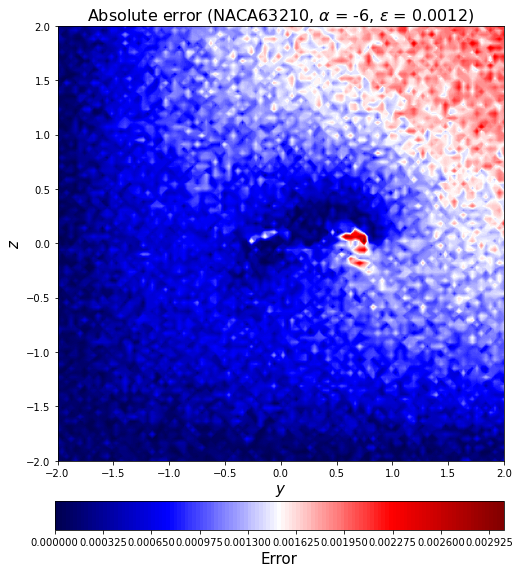

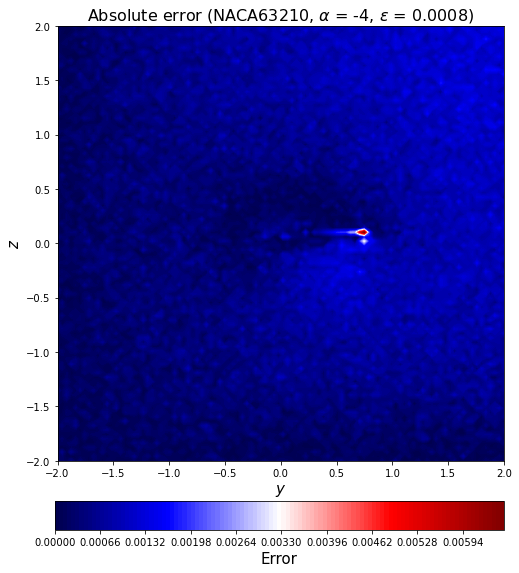

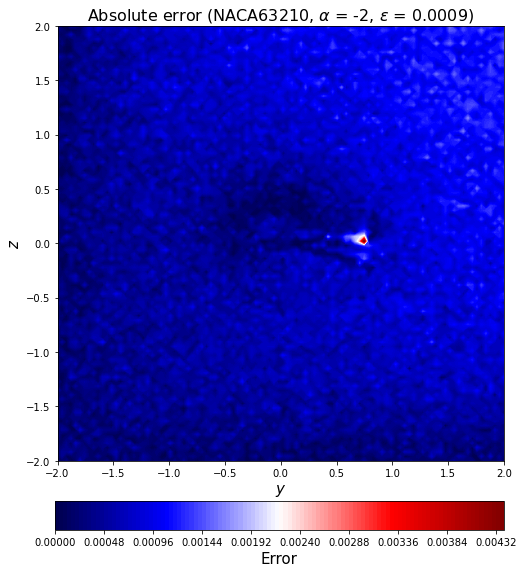

...

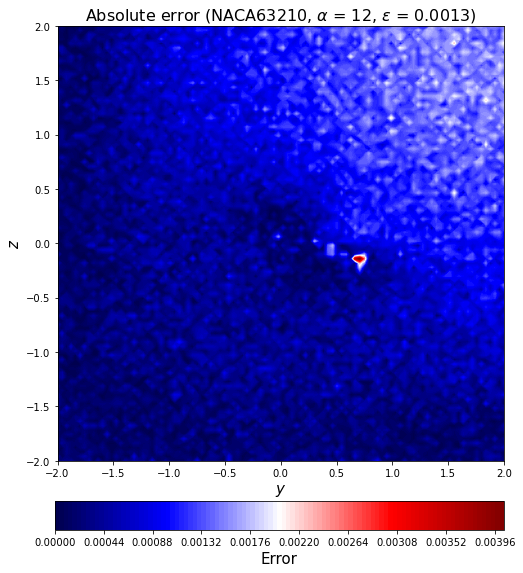

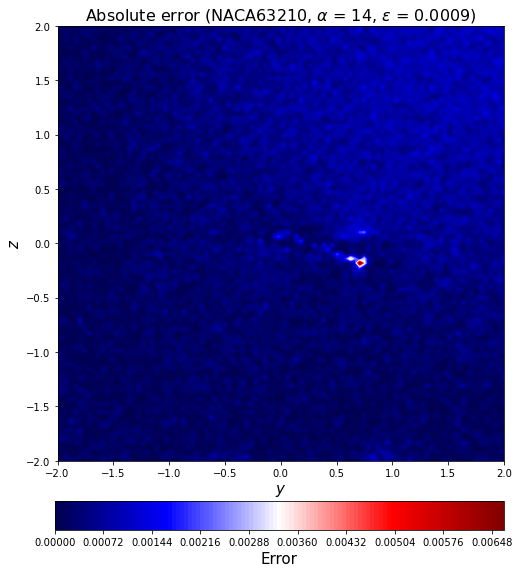

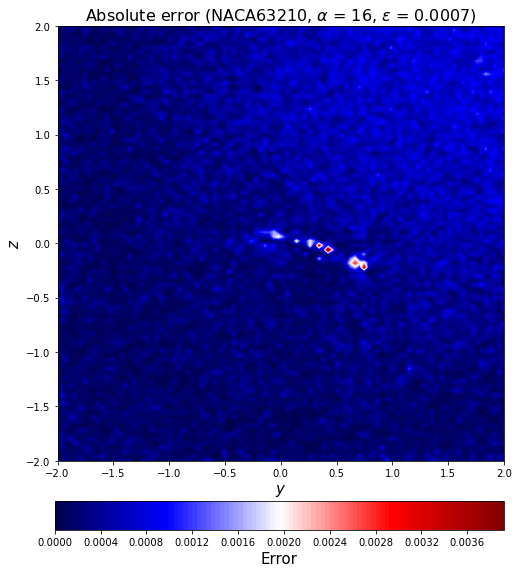

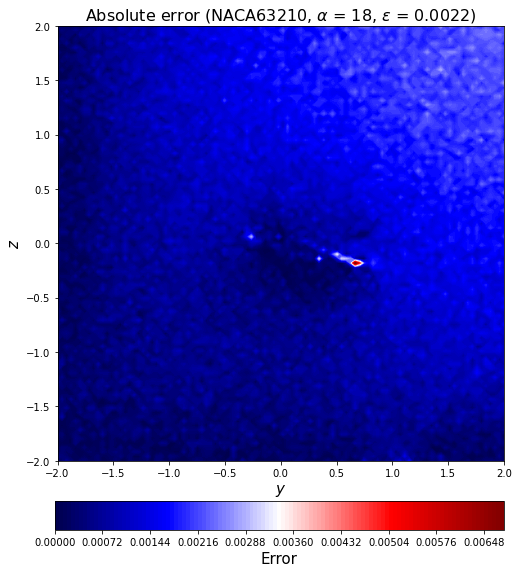

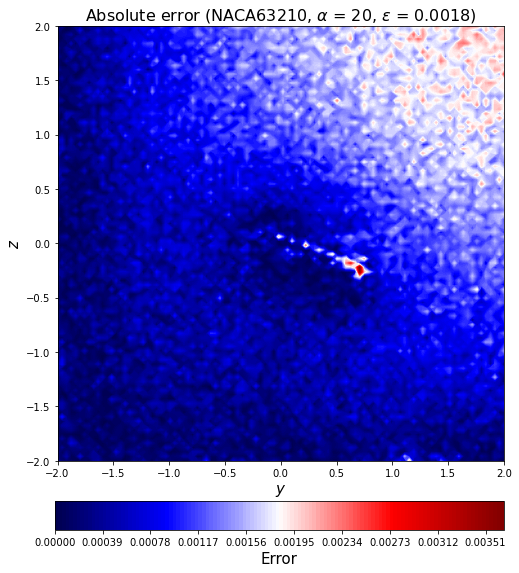

In [59]:
for c in range(0,16):
    error_test_abs2_rotate = error_test_abs[2*16+c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[2*16+c])[3:-2],
                                                                       aa_test[2*16+c], l2_error_test_list[2*16+c]), fontsize=16)
    ax5.set_xlabel('$y$', fontsize=15)
    ax5.set_ylabel('$z$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[2*16+c])[3:-2])+str(aa_test[2*16+c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

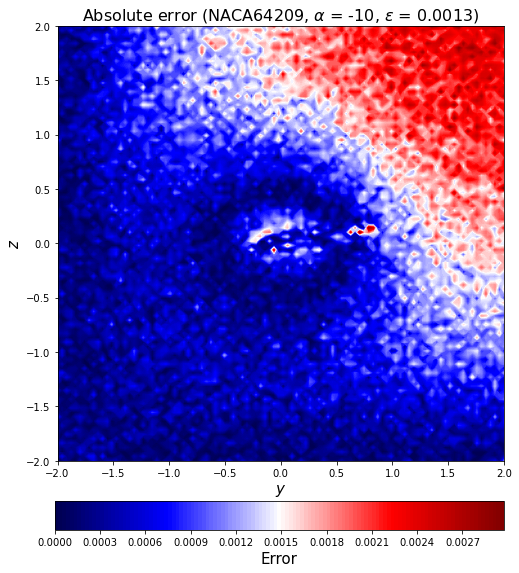

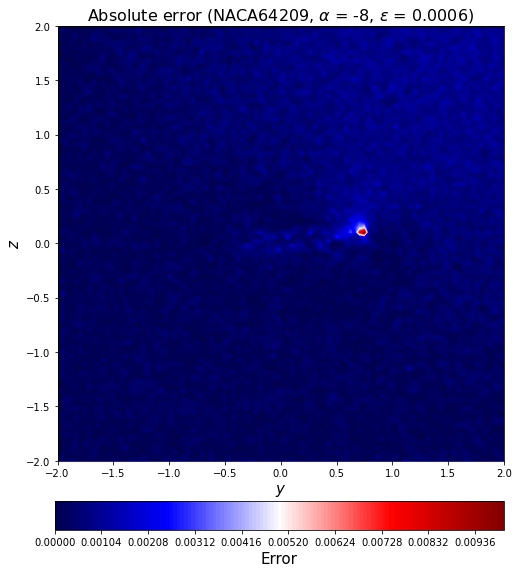

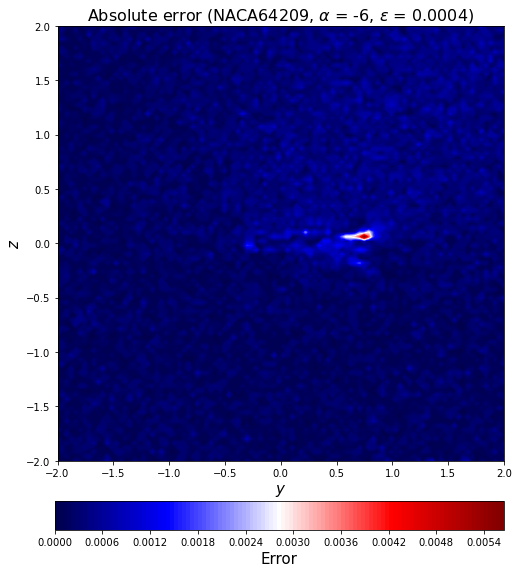

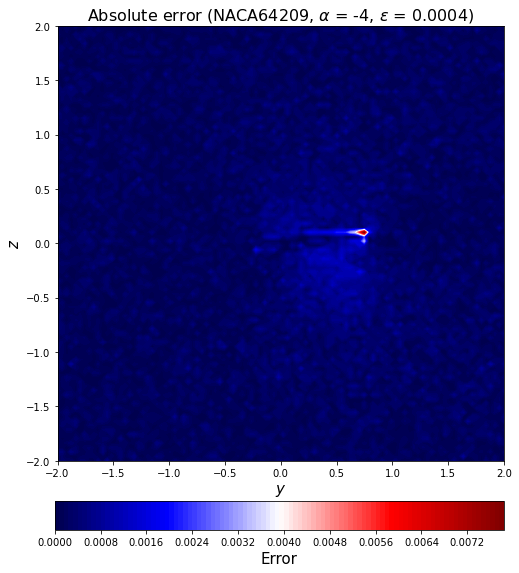

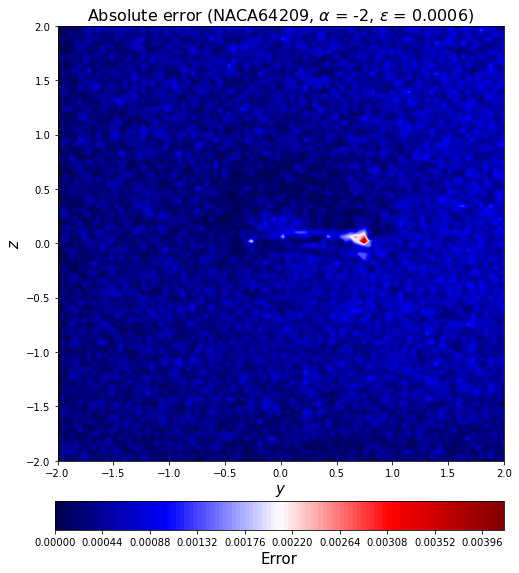

...

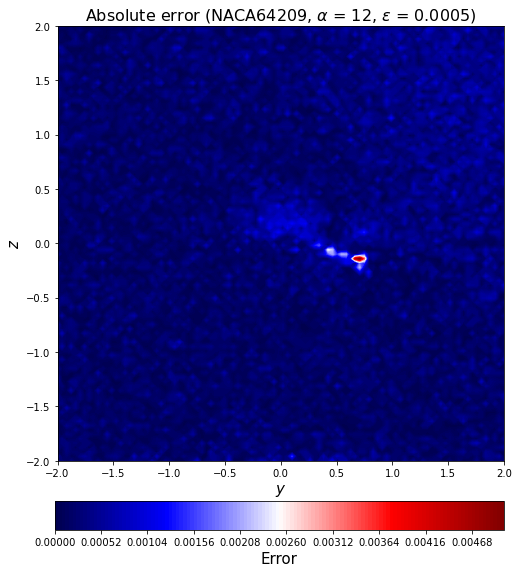

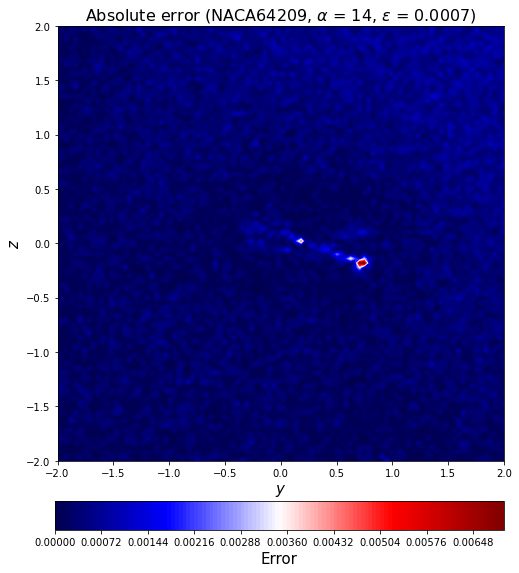

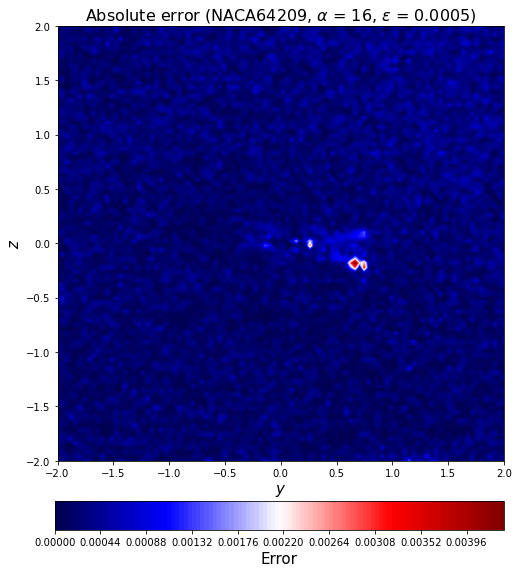

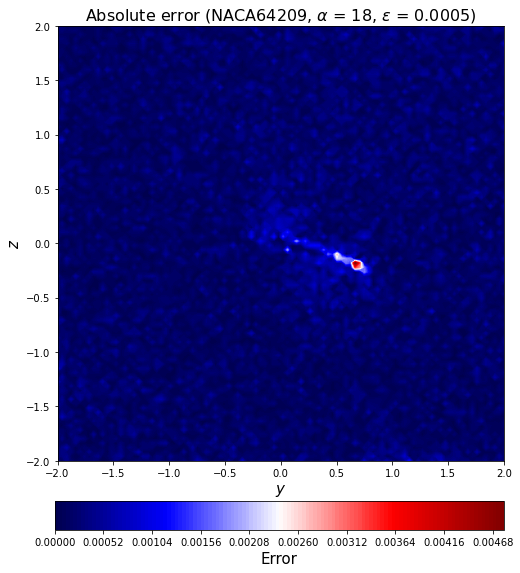

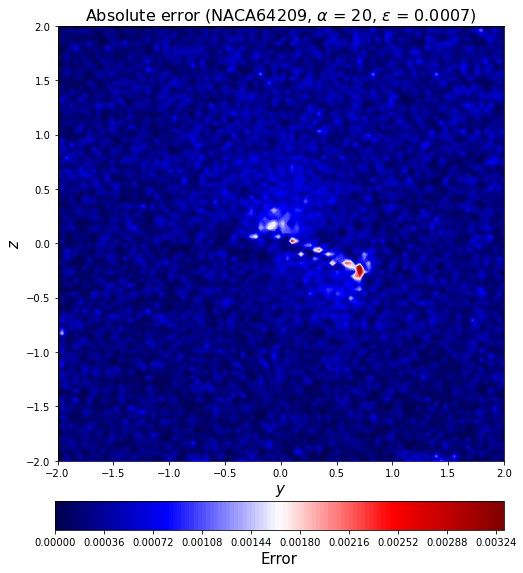

In [60]:
for c in range(0,16):
    error_test_abs2_rotate = error_test_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[c])[3:-2],
                                                                       aa_test[c], l2_error_test_list[c]), fontsize=16)
    ax5.set_xlabel('$y$', fontsize=15)
    ax5.set_ylabel('$z$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

In [61]:
MAPE_train = (np.sum(np.abs(np.sum(y_train)-np.sum(decoded_train))) / np.abs(np.sum(y_train)))/(y_train.shape[0]/16)*100
acc_train = 1-MAPE_train

In [62]:
MAPE_test = (np.sum(np.abs(np.sum(y_test)-np.sum(decoded_test))) / np.abs(np.sum(y_test)))/(y_test.shape[0]/16)*100
acc_test = 1-MAPE_test

In [63]:
print(MAPE_train)
print(acc_train)

2.6772304155828152e-05
0.9999732276958442


In [64]:
print(MAPE_test)
print(acc_test)

0.004342056508532257
0.9956579434914677


In [65]:
MAPE_train_list = []
acc_train_list = []
for i in range(0, len(aa_train)):
    MAPE_train_data = (np.sum(np.abs(y_train[i]-decoded_train[i])) / np.sum(np.abs(y_train[i])))/(y_train.shape[0]/16)*100
    MAPE_train_list.append(MAPE_train_data)
    acc_train_data = 1 - MAPE_train_data
    acc_train_list.append(acc_train_data)
print(MAPE_train_list)
print(acc_train_list)

[0.0003818488890460244, 0.00038334709675465277, 0.00033830837634343423, 0.0003823973952286661, 0.0003733509800259066, 0.0003764697381332815, 0.0003662125774446568, 0.00038526301385729525, 0.00037491574225337424, 0.00038258691869139046, 0.00042148995800133954, 0.0005680629986439931, 0.000463077930621032, 0.00048046289396067894, 0.0005243578425754401, 0.0005854265073741738, 0.0004899598515543959, 0.0003381949099543699, 0.00029644457443864735, 0.0003806114007340337, 0.0004043649224907763, 0.00039542888401098157, 0.00040630200015222273, 0.0004620725702794772, 0.00037270823859308867, 0.00039632603143792313, 0.0003766142439198366, 0.0004505657965455385, 0.0005018395250846208, 0.0005249738130586946, 0.0005133172867869358, 0.0007040958850673944, 0.0003165456731816066, 0.0002512059563531652, 0.00023557137035982027, 0.0005286720882014711, 0.00029677612347150045, 0.0006139792733868052, 0.0005726782880781579, 0.00045011201321958457, 0.0004250114044453281, 0.0002715694184168393, 0.00034917601442135

In [66]:
MAPE_test_list = []
acc_test_list = []
for i in range(0, len(aa_test)):
    MAPE_test_data = (np.sum(np.abs(y_test[i]-decoded_test[i])) / np.sum(np.abs(y_test[i])))/(y_test.shape[0]/16)*100
    MAPE_test_list.append(MAPE_test_data)
    acc_test_data = 1 - MAPE_test_data
    acc_test_list.append(acc_test_data)
print(MAPE_test_list)
print(acc_test_list)

[0.002432662319803795, 0.0011285500522881554, 0.0007507145102705019, 0.0007309619068558479, 0.0013393742034345664, 0.0012414257582321984, 0.001027925610198015, 0.0006623572122265988, 0.0009585187653373866, 0.001463644529027498, 0.00107674009631623, 0.001025278931572666, 0.001406852001634002, 0.0010450813942474962, 0.0009605532604813394, 0.0014778270128201717, 0.009266227060072402, 0.009053647349038083, 0.007004290400365244, 0.0012195400041124223, 0.003941350134086176, 0.006159681089020421, 0.009450173687445057, 0.008141154838218416, 0.011903490551632255, 0.008391268369266158, 0.0029025129095302605, 0.004987316512276741, 0.001326229336712983, 0.008626118828452567, 0.004693228054248174, 0.008891008662682663, 0.004369295714465508, 0.0031968150689846617, 0.002478067125762467, 0.0017446443592451808, 0.0019863142915528273, 0.002353731511896528, 0.0008552047649506559, 0.0017629353730504607, 0.0010003801442264194, 0.0015501329062742773, 0.0013245139978418608, 0.002603339569045714, 0.0017987965

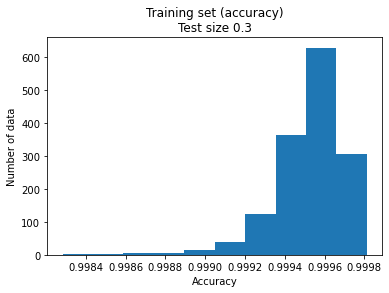

In [67]:
plt.hist(acc_train_list)
plt.title('Training set (accuracy)\nTest size 0.3')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
#plt.grid()
save_acc_name = "20221030Accuracy_Poisson_bc2(training).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

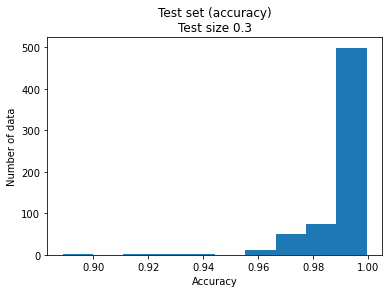

In [68]:
plt.hist(acc_test_list)
plt.title('Test set (accuracy)\nTest size 0.3')
plt.ylabel('Number of data')
plt.xlabel('Accuracy')
save_acc_name = "20221030Accuracy_Poisson_bc2(test).jpg"
plt.savefig(save_acc_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

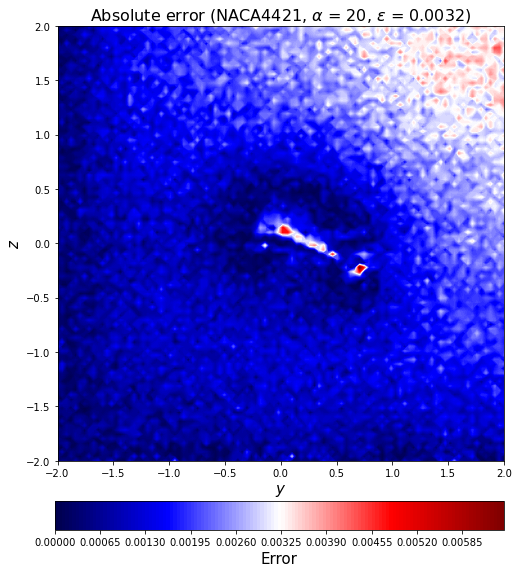

In [69]:
error_test_abs2_rotate = error_test_abs[-1].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-1])[3:-2],
                                                                   aa_test[-1], l2_error_test_list[-1]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-1])[3:-2])+str(aa_test[-1])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

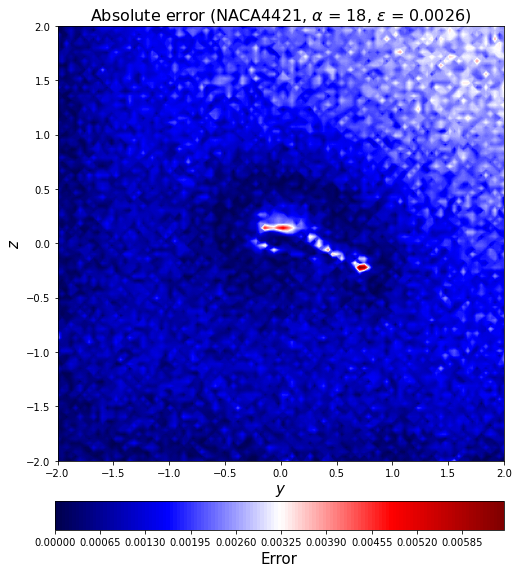

In [70]:
error_test_abs2_rotate = error_test_abs[-2].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-2])[3:-2],
                                                                   aa_test[-2], l2_error_test_list[-2]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-2])[3:-2])+str(aa_test[-2])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

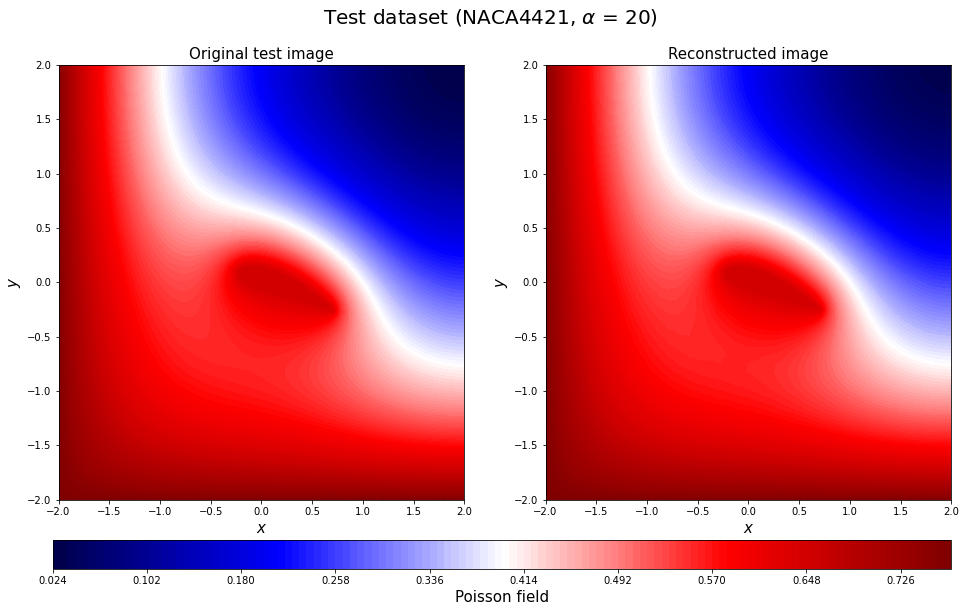

In [71]:
c=-1
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

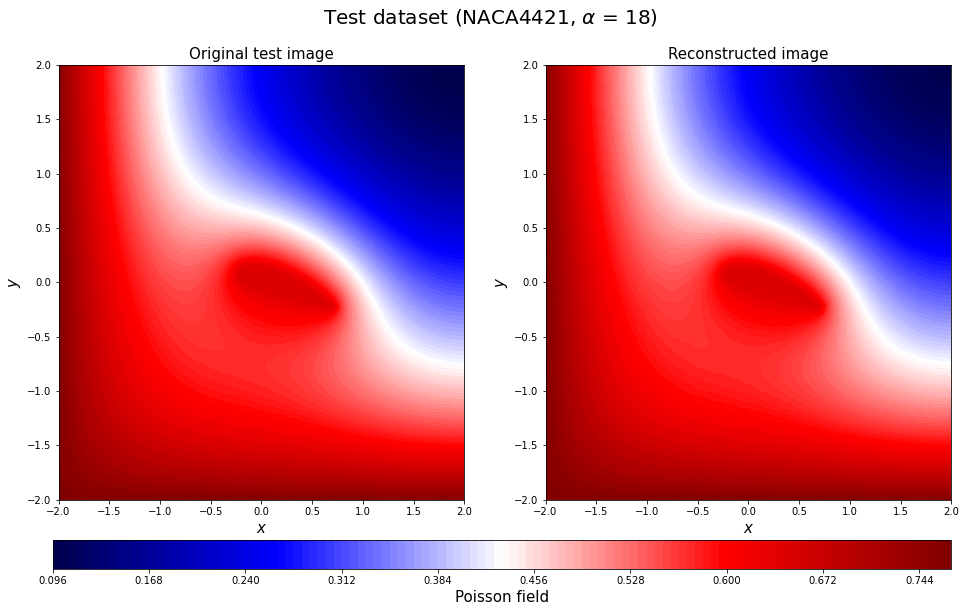

In [72]:
c=-2
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

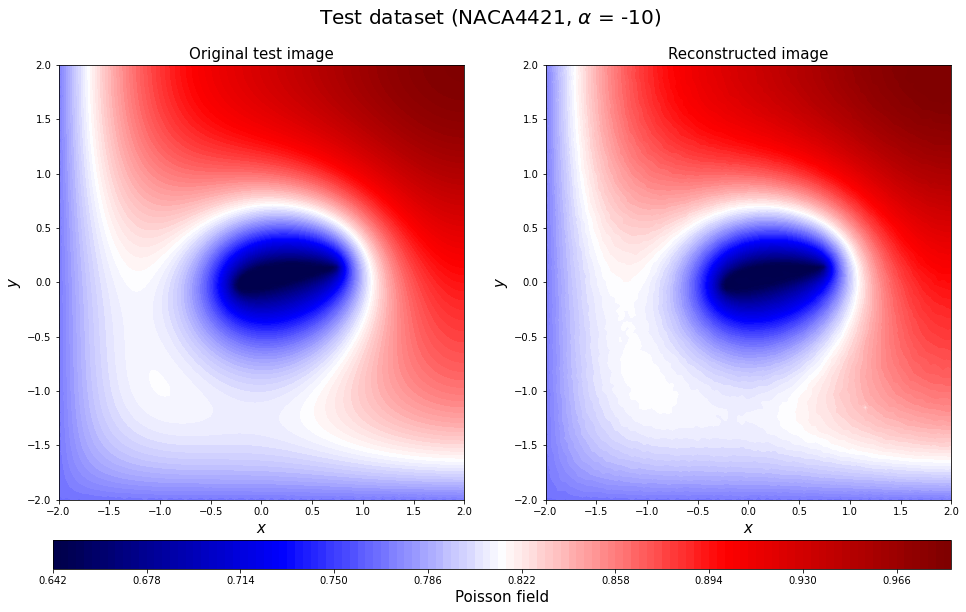

In [73]:
c=-16
plt.figure(figsize=(16, 8))
y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

xrange = np.linspace(-2, 2, n_grid)
yrange = np.linspace(-2, 2, n_grid)
xmesh, ymesh = np.meshgrid(xrange, yrange)

ax = plt.subplot(1, 2, 1)
a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Original test image', fontsize=15)

# Display reconstruction
ax = plt.subplot(1, 2, 2)
a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                  vmax=np.max(y_test0_rotate), levels=128, cmap='seismic')
ax.set_xlabel('$x$', fontsize=15)
ax.set_ylabel('$y$', fontsize=15)
ax.set_title('Reconstructed image', fontsize=15)
cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
cbar.set_label('Poisson field', fontsize=15)
#cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

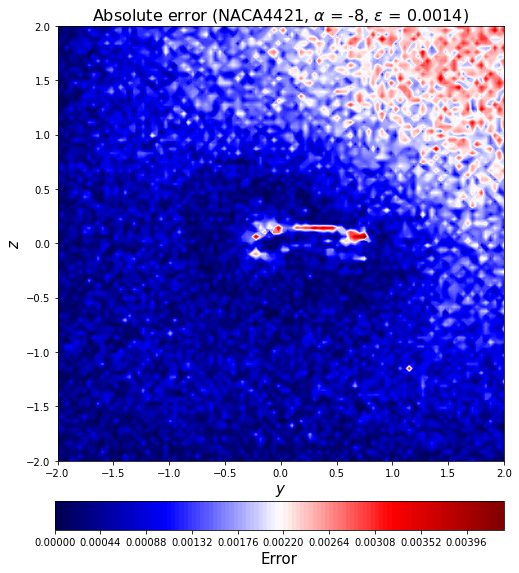

In [74]:
error_test_abs2_rotate = error_test_abs[-15].reshape(n_grid,n_grid).T

fig5 = plt.figure(figsize = (8, 8))
ax5 = fig5.add_subplot(111)
mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[-15])[3:-2],
                                                                   aa_test[-15], l2_error_test_list[-15]), fontsize=16)
ax5.set_xlabel('$y$', fontsize=15)
ax5.set_ylabel('$z$', fontsize=15)

cax = plt.axes([0.12, 0.005, 0.78, 0.05])
cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
cbar.set_label('Error', fontsize=15)

save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[-15])[3:-2])+str(aa_test[-15])+".jpg"
plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
plt.show()

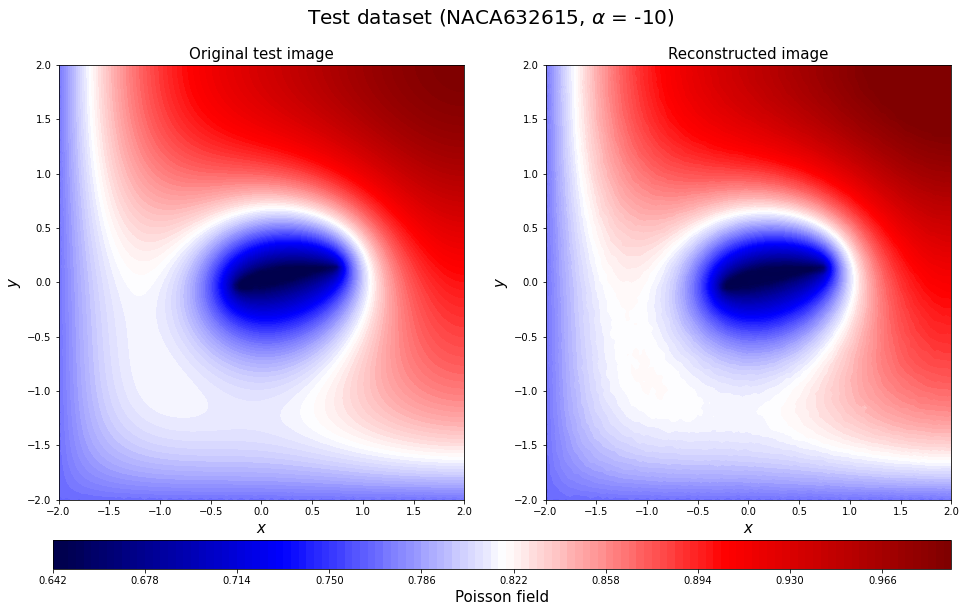

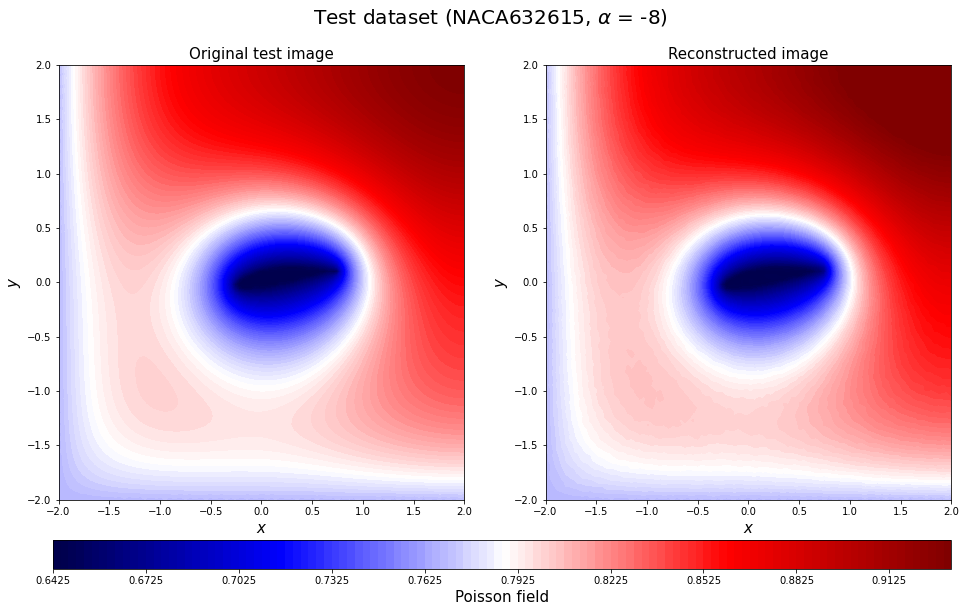

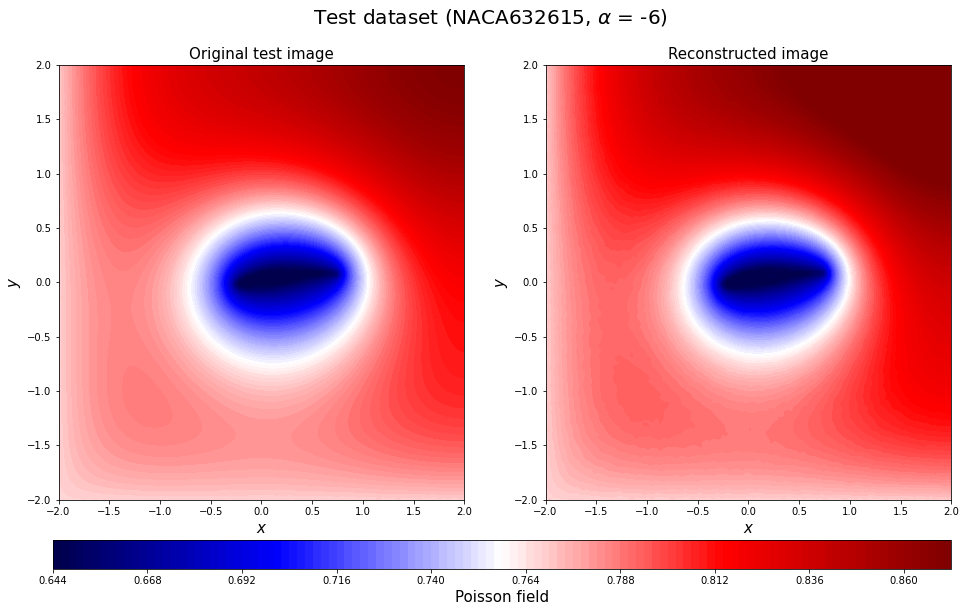

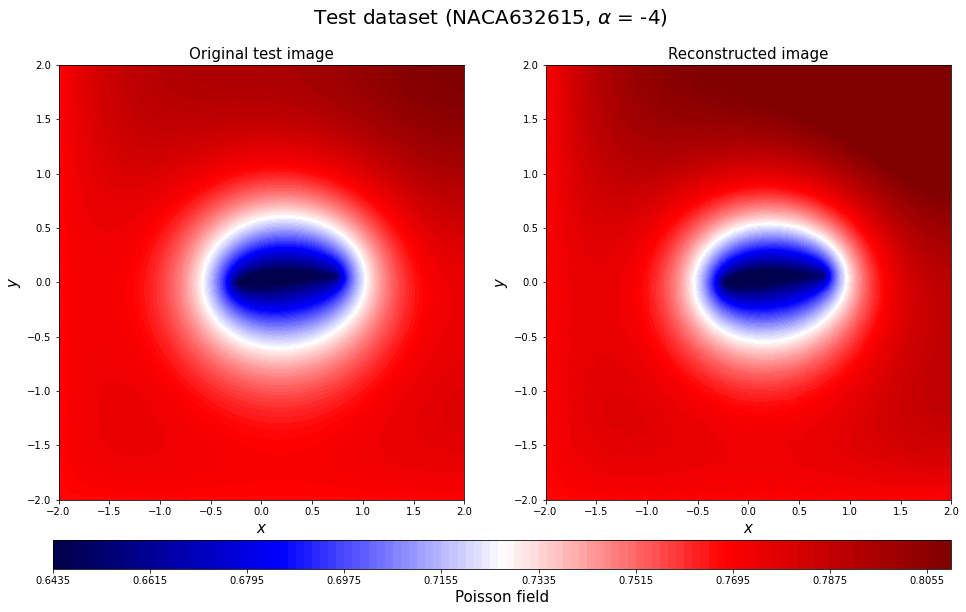

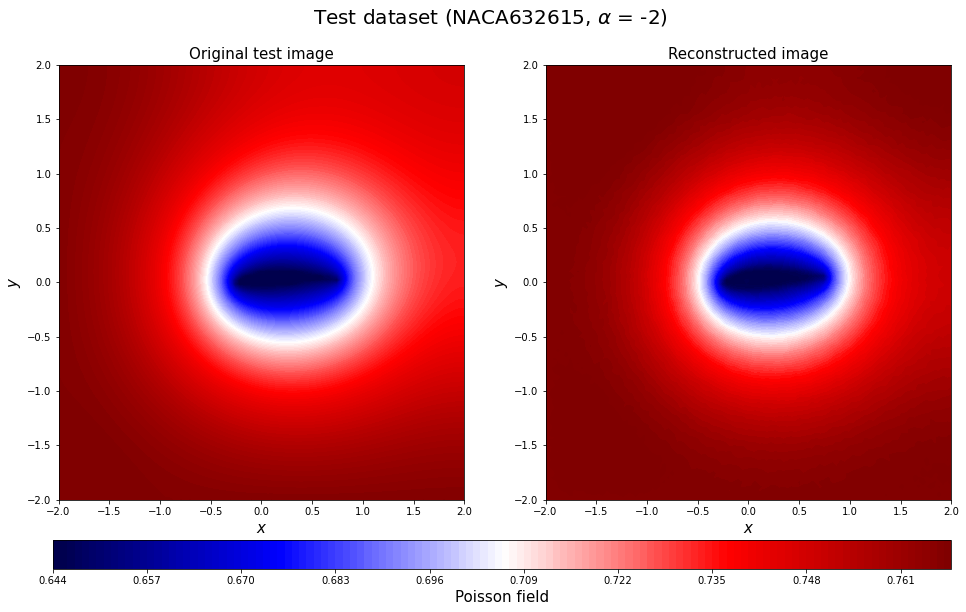

...

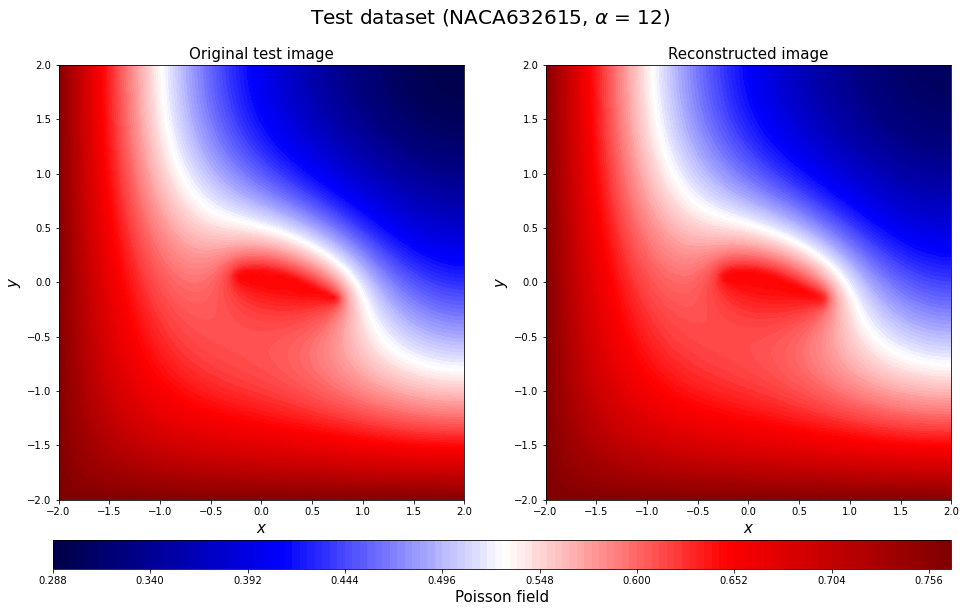

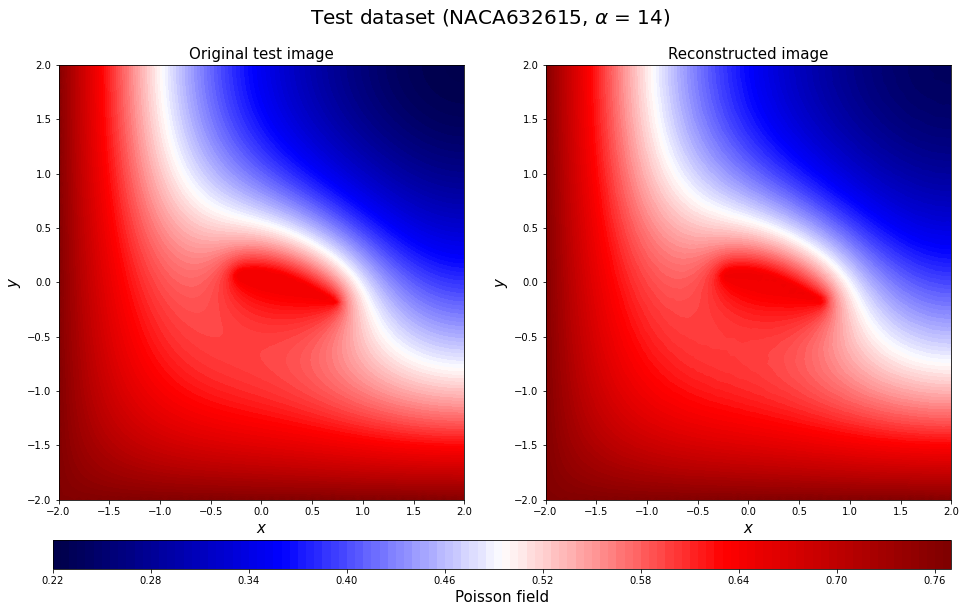

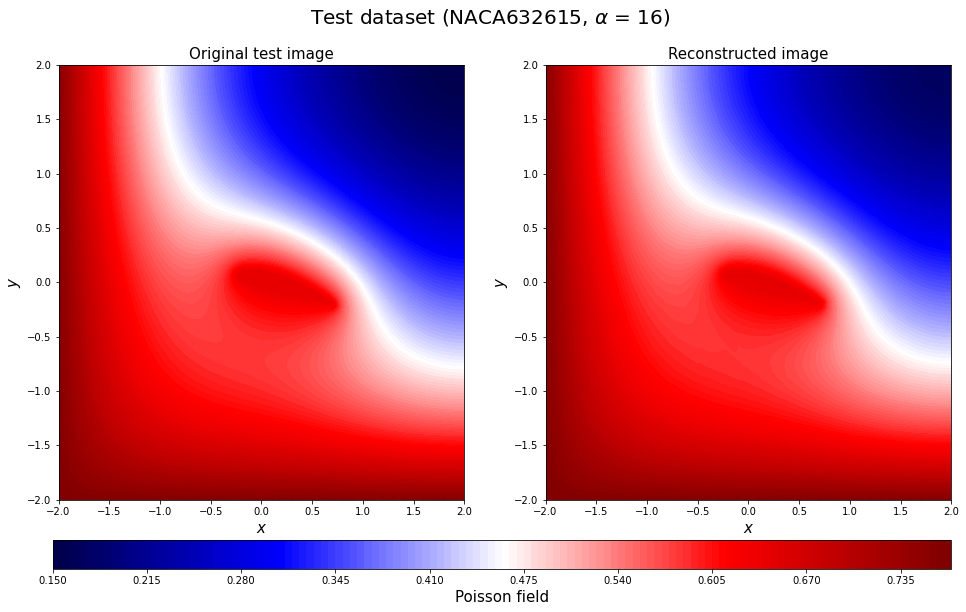

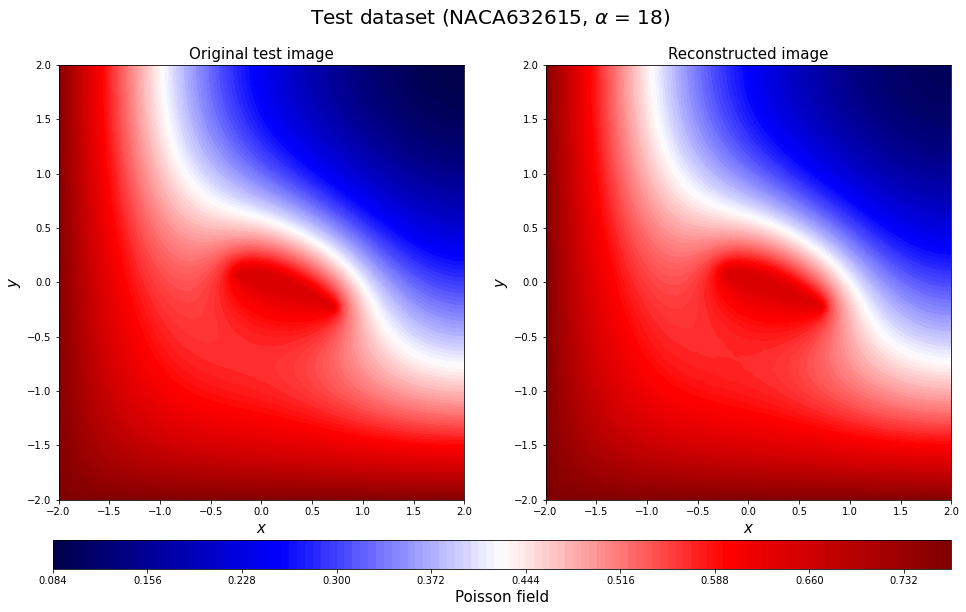

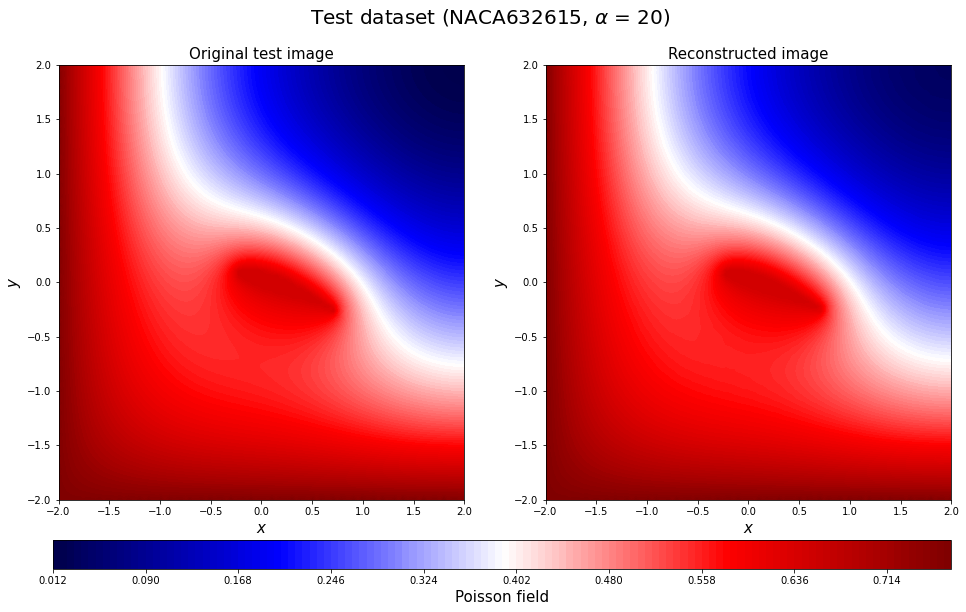

In [75]:
for c in range(96,112):
    plt.figure(figsize=(16, 8))
    y_test0_rotate = y_test[c].reshape(n_grid,n_grid).T
    decoded_rotate = decoded_test[c].reshape(n_grid,n_grid).T

    xrange = np.linspace(-2, 2, n_grid)
    yrange = np.linspace(-2, 2, n_grid)
    xmesh, ymesh = np.meshgrid(xrange, yrange)

    ax = plt.subplot(1, 2, 1)
    a1 = plt.contourf(xmesh, ymesh, y_test0_rotate, vmin=np.min(y_test0_rotate),
                      vmax = np.max(y_test0_rotate),levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Original test image', fontsize=15)

    # Display reconstruction
    ax = plt.subplot(1, 2, 2)
    a2 = plt.contourf(xmesh, ymesh, decoded_rotate, vmin=np.min(y_test0_rotate),
                      vmax = np.max(y_test0_rotate),levels=128, cmap='seismic')
    ax.set_xlabel('$x$', fontsize=15)
    ax.set_ylabel('$y$', fontsize=15)
    ax.set_title('Reconstructed image', fontsize=15)
    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(a1, cax=cax, orientation="horizontal")
    cbar.set_label('Poisson field', fontsize=15)
    #cbar.set_ticks([-0.5, -0.4, -0.3, -0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9])

    plt.suptitle(r'Test dataset (%s, $\alpha$ = %d)' %(np.array2string(geo_test[c])[3:-2], aa_test[c]),fontsize=20)
    save_fig_name = "20221030Prediction_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()

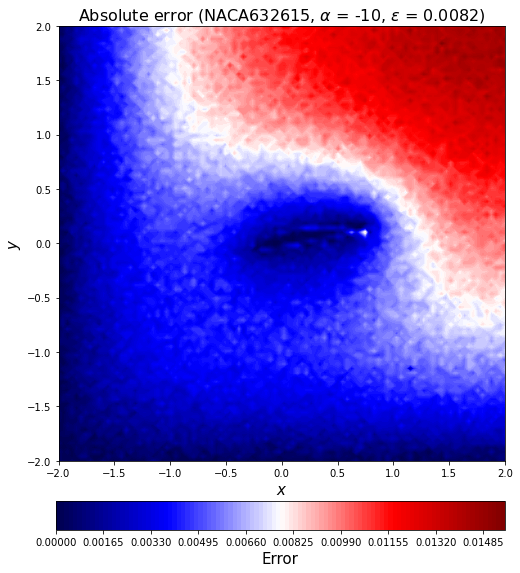

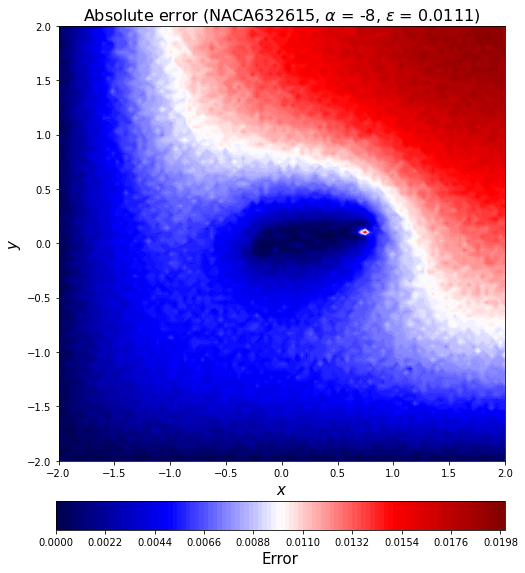

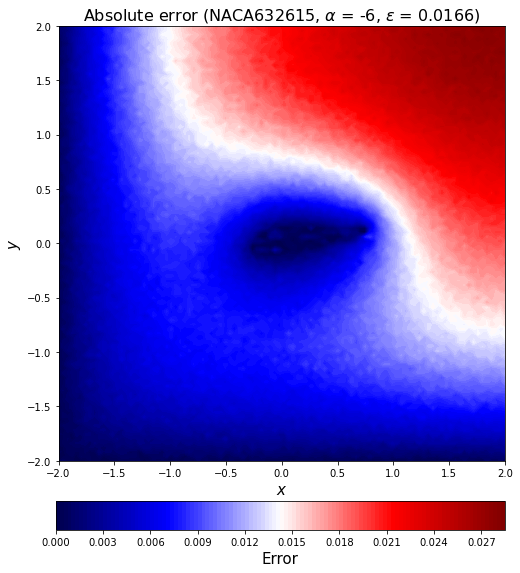

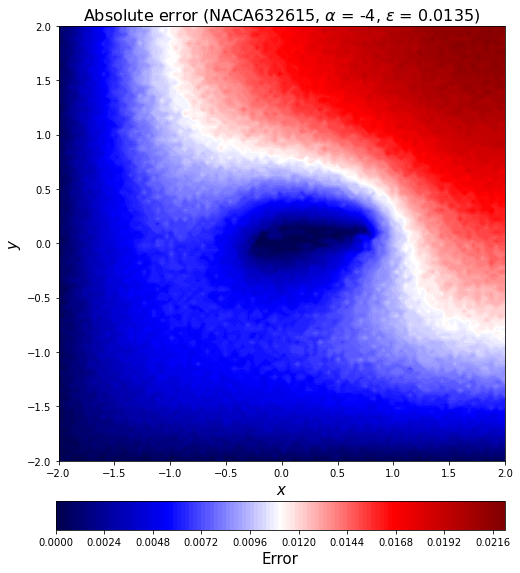

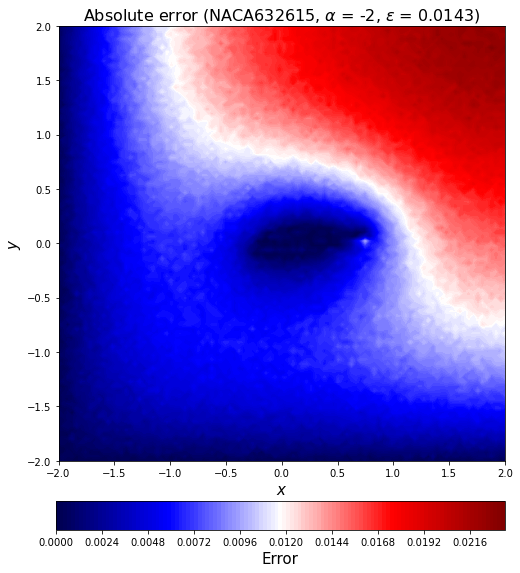

...

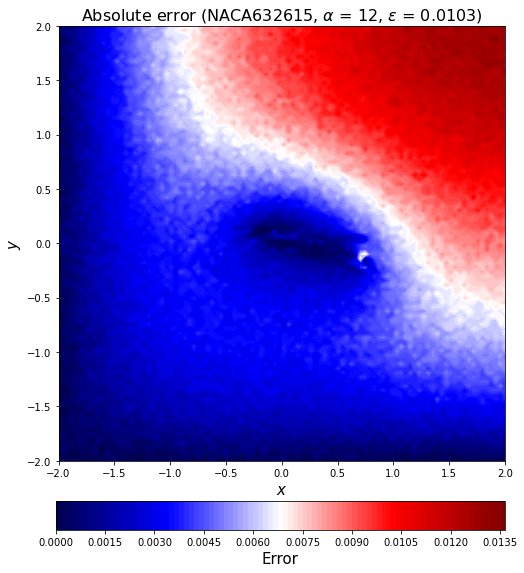

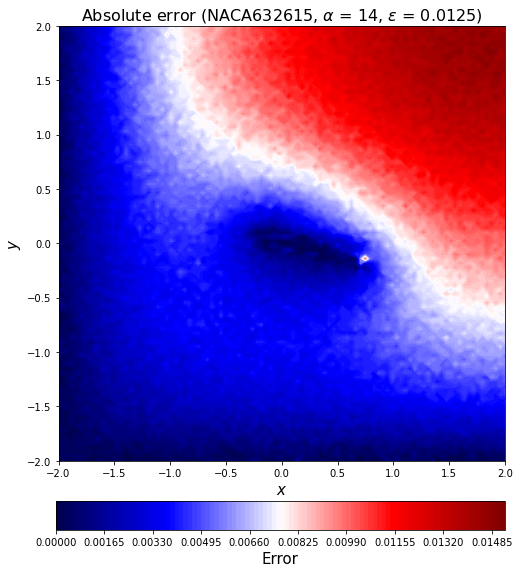

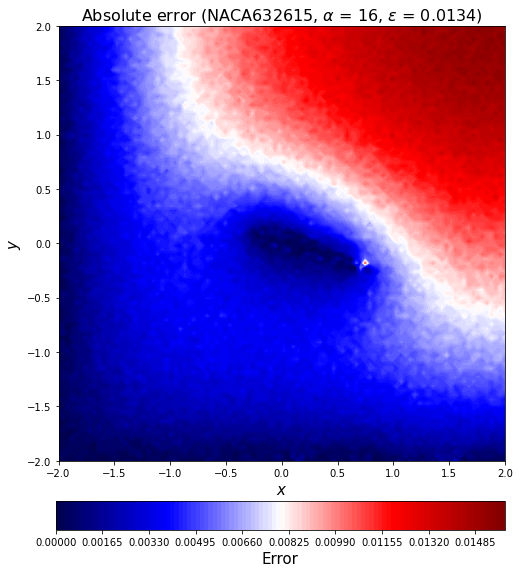

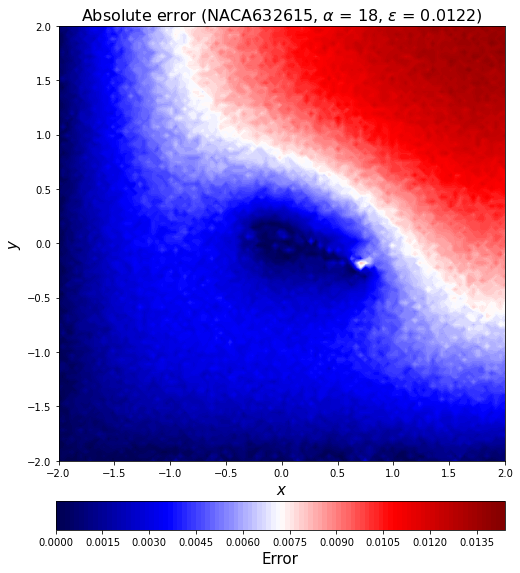

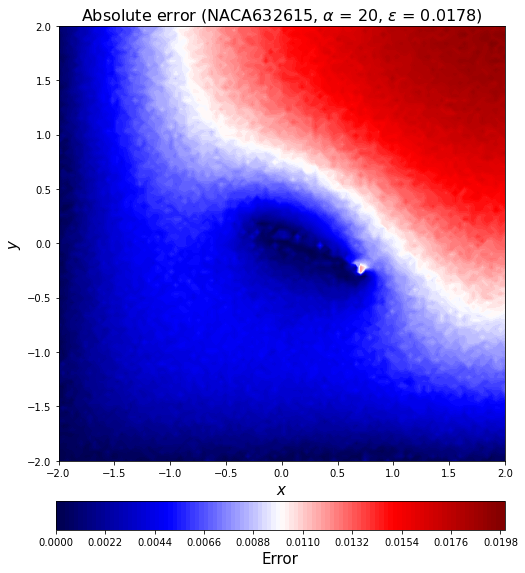

In [76]:
for c in range(96,112):
    error_test_abs2_rotate = error_test_abs[c].reshape(n_grid,n_grid).T

    fig5 = plt.figure(figsize = (8, 8))
    ax5 = fig5.add_subplot(111)
    mappable = ax5.contourf(xmesh, ymesh, error_test_abs2_rotate, levels=128, cmap='seismic')
    ax5.set_title(r'Absolute error (%s, $\alpha$ = %d, $\epsilon$ = %.4f)' %(np.array2string(geo_test[c])[3:-2],
                                                                       aa_test[c], l2_error_test_list[c]), fontsize=16)
    ax5.set_xlabel('$x$', fontsize=15)
    ax5.set_ylabel('$y$', fontsize=15)

    cax = plt.axes([0.12, 0.005, 0.78, 0.05])
    cbar = plt.colorbar(mappable, cax=cax, orientation="horizontal")
    cbar.set_label('Error', fontsize=15)

    save_fig_name = "20221030PredictionError_Poisson_bc2(test)"+str(np.array2string(geo_test[c])[3:-2])+str(aa_test[c])+".jpg"
    plt.savefig(save_fig_name, dpi=300, bbox_inches='tight', pad_inches=0.3)
    plt.show()